<a href="https://colab.research.google.com/github/VidurMushran/NEvL_but_automated/blob/main/NEvL_but_Morphometrics_v2.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

## Mount

In [ ]:
from google.colab import drive
drive.mount('/content/drive/')

Mounted at /content/drive/


In [ ]:
%cd '/content/drive/MyDrive/Research/CURE/NEvL but Morphometrics/'
# %ls

/content/drive/MyDrive/Research/CURE/NEvL but Morphometrics


## Import

In [ ]:
import warnings

import matplotlib.pyplot as plt
import numpy as np
import pandas as pd

from sklearn.preprocessing import StandardScaler

from sklearn.model_selection import train_test_split, GroupShuffleSplit
from sklearn.utils.class_weight import compute_class_weight
from sklearn.metrics import confusion_matrix, ConfusionMatrixDisplay, classification_report

from sklearn.exceptions import ConvergenceWarning
warnings.filterwarnings("ignore", category=ConvergenceWarning)

In [ ]:
pd.set_option('display.width', 500)

In [ ]:
random_state = 42

## W&B Login

In [ ]:
!pip install wandb -qU
import wandb

In [ ]:
wandb.login()
# 051c94347e461dd452936445ae8e190adc68af3c

wandb: Using wandb-core as the SDK backend.  Please refer to https://wandb.me/wandb-core for more information.


<IPython.core.display.Javascript object>

## Data Preparation

#### George Columns

In [ ]:
george_cols = ['cellf.cy5.b.sd',
  'cellf.dapifitc.m.eccentricity',
  'cellf.dapifitc.b.mean',
  'cellf.fitc.b.q05',
  'cellf.cy5.m.eccentricity',
  'nucleusf.dapi.b.mean',
  'nucleus_cell_dist',
  'cellf.tritccy5.b.mean',
  'cellf.0.m.eccentricity',
  'cellf.tritcfitc.m.eccentricity',
  'cellf.fitc.b.q095',
  'cellf.tritc.b.q005',
  'cellf.fitc.b.q005',
  'cellf.cy5.b.q095',
  'cellf.cy5.m.majoraxis',
  'nucleusf.dapi.b.q05',
  'cellf.fitc.b.mean',
  'cellf.dapicy5.b.q05',
  'cellf.cy5fitc.b.q05',
  'cellf.tritc.b.q05',
  'cellf.tritc.m.eccentricity',
  'cellf.tritccy5.b.q05',
  'nucleusf.0.s.radius.max',
  'cellf.dapicy5.m.majoraxis',
  'cellf.cy5.b.mean',
  'cellf.cy5fitc.b.q005',
  'cellf.cy5.b.q05',
  'cellf.fitc.m.majoraxis',
  'cellf.0.s.radius.sd',
  'cellf.dapitritc.b.q05',
  'cellf.cy5.b.q005',
  'cellf.dapifitc.b.sd',
  'cellf.0.m.majoraxis',
  'cellf.0.s.radius.mean',
  'cellf.tritccy5.b.q095',
  'cellf.tritccy5.m.majoraxis',
  'cellf.fitc.b.sd',
  'cellf.dapicy5.b.mean',
  'cellf.0.s.radius.max',
  'cellf.dapitritc.m.eccentricity',
  'cellf.dapitritc.b.q005',
  'cellf.dapitritc.b.mad',
  'cellf.dapifitc.b.mad',
  'nucleusf.0.s.perimeter',
  'nucleusf.0.m.eccentricity',
  'cellf.tritc.b.mean',
  'nucleusf.0.s.radius.mean',
  'cellf.tritcfitc.b.sd',
  'cellf.tritcfitc.b.q05',
  'tritc_cy5_ratio',
  'cellf.dapitritc.b.sd',
  'nucleusf.dapi.b.mad',
  'cellf.0.s.area',
  'cellf.tritcfitc.b.mad',
  'cellf.fitc.m.eccentricity',
  'cellf.tritccy5.b.sd',
  'nucleusf.0.s.radius.sd',
  'cellf.cy5.b.mad',
  'nucleusf.dapi.m.eccentricity',
  'cellf.tritc.b.q095',
  'cellf.cy5fitc.b.mad',
  'cellf.dapicy5.b.q095',
  'cellf.dapicy5.b.q005',
  'nucleusf.0.m.majoraxis',
  'cellf.dapitritc.b.mean',
  'nucleusf.dapi.m.majoraxis',
  'cellf.0.s.perimeter',
  'cellf.dapifitc.b.q005',
  'cellf.dapicy5.b.mad',
  'cellf.dapitritc.m.majoraxis',
  'cellf.cy5fitc.b.sd',
  'nucleusf.dapi.b.q005',
  'nucleusf.dapi.b.q095',
  'cellf.dapifitc.m.majoraxis',
  'cellf.dapifitc.b.q05',
  'cellf.cy5fitc.b.q095',
  'cellf.tritccy5.b.q005',
  'cellf.tritcfitc.m.majoraxis',
  'cellf.tritc.b.sd',
  'cellf.cy5fitc.b.mean',
  'nucleusf.dapi.b.sd',
  'cellf.dapifitc.b.q095',
  'cellf.tritccy5.m.eccentricity',
  'cellf.tritc.m.majoraxis',
  'cellf.tritcfitc.b.mean',
  'cellf.dapicy5.b.sd',
  'cellf.tritcfitc.b.q005',
  'nucleusf.0.s.area',
  'cellf.0.s.radius.min',
  'cellf.tritcfitc.b.q095',
  'cellf.cy5fitc.m.eccentricity',
  'cellf.tritc.b.mad',
  'nucleusf.0.s.radius.min',
  'cellf.tritccy5.b.mad',
  'cellf.dapitritc.b.q095',
  'cellf.fitc.b.mad',
  'cellf.dapicy5.m.eccentricity',
  'cellf.cy5fitc.m.majoraxis']

#### Data Loading

Changing classification to diagnosis so diagnosis can refer to patient level condition & classification can refer to cell level channel type classifier

In [ ]:
df = pd.read_csv("NEvL+ND_df.csv", sep=",", low_memory=False).drop(columns=['Unnamed: 0', 'data'])

df.rename(columns={"x": "cell_x", "y": "cell_y", "classification": "DX_multi", "cell_density": "event_density"}, inplace=True)

df.loc[df['DX_multi'] == 'Normal', 'DX'] = 'Normal'
df.loc[df['DX_multi'] != 'Normal', 'DX'] = 'BC'

df

,slide_id,frame_id,cell_id,cell_x,cell_y,cellf.0.m.majoraxis,cellf.0.m.eccentricity,cellf.0.m.theta,cellf.0.s.area,cellf.0.s.perimeter,...,tritc_cy5_ratio,dapi_count_ocular,tube_id,wbc_count,patient_id,DX_multi,dapi+,event_count,event_density,DX
0,047353,749,270,371,921,31.941112,0.818734,-1.384130,446,78,...,11.795259,2013254,04735,10.6,BC-OPT-002,Early BC,True,6,0.000032,BC
1,047353,749,1137,384,940,32.446574,0.767024,-0.045462,515,75,...,20.475000,2013254,04735,10.6,BC-OPT-002,Early BC,True,6,0.000032,BC
2,047353,850,358,63,539,36.864539,0.764560,1.179791,646,105,...,0.647681,2013254,04735,10.6,BC-OPT-002,Early BC,True,6,0.000032,BC
3,047353,998,108,1123,454,20.632920,0.768224,0.556618,200,48,...,0.258780,2013254,04735,10.6,BC-OPT-002,Early BC,True,6,0.000032,BC
4,047353,1758,1110,674,554,15.076722,0.551064,-1.074343,149,38,...,2.135838,2013254,04735,10.6,BC-OPT-002,Early BC,True,6,0.000032,BC
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
8642,0B68502,1791,832,959,316,17.747126,0.675035,-1.475433,182,43,...,3.478261,2344587,0B685,7.0,NBD6163,Normal,True,40,0.000119,Normal
8643,0B68502,1927,1036,885,493,14.095868,0.438737,-1.495726,140,36,...,1.348155,2344587,0B685,7.0,NBD6163,Normal,True,40,0.000119,Normal
8644,0B68502,1983,1403,1114,634,12.838645,0.540525,1.174552,108,33,...,NaN,2344587,0B685,7.0,NBD6163,Normal,False,40,0.000119,Normal
8645,0B68502,2131,738,602,25,13.763339,0.344094,-0.910843,139,37,...,1.525743,2344587,0B685,7.0,NBD6163,Normal,True,40,0.000119,Normal


#### Adding in Manual Classification

In [ ]:
manual_classification = pd.read_csv("updated_data.csv", sep=",", low_memory=False).drop(columns=['Unnamed: 0'])

manual_classification.rename(columns={"Patient": "patient_id"}, inplace=True)

manual_classification = manual_classification[['slide_id', 'frame_id', 'cell_id', 'manual_classification']]

# Adds preceding 0 to integer ids to match the NEvL slides file
int_ids = lambda x: '0' + str(x) if len(x) == 5 else x
manual_classification['slide_id'] = manual_classification['slide_id'].map(int_ids)

In [ ]:
manual_classification

,slide_id,frame_id,cell_id,manual_classification
0,047353,749,270,D|CK|V
1,047353,749,1137,D|CK|V
2,047353,850,358,D|CK|CD
3,047353,998,108,Dapi- Cell
4,047353,1758,1110,D|CK|V|CD
...,...,...,...,...
5692,0AFBF02,2155,1202,Dapi- Cell
5693,0AFBF02,2173,1250,Dapi- Cell
5694,0AFBF02,2223,1104,Dapi- Cell
5695,0AFBF02,2236,627,Dapi- Cell


In [ ]:
# Joining on patient_id, slide_id, frame_id, cell_id to add in manual classification
df = df.join(manual_classification.set_index(['slide_id', 'frame_id', 'cell_id']), on=['slide_id', 'frame_id', 'cell_id'])

In [ ]:
df ['manual_classification'] = df['manual_classification'].fillna('Unclassified')
df

,slide_id,frame_id,cell_id,cell_x,cell_y,cellf.0.m.majoraxis,cellf.0.m.eccentricity,cellf.0.m.theta,cellf.0.s.area,cellf.0.s.perimeter,...,dapi_count_ocular,tube_id,wbc_count,patient_id,DX_multi,dapi+,event_count,event_density,DX,manual_classification
0,047353,749,270,371,921,31.941112,0.818734,-1.384130,446,78,...,2013254,04735,10.6,BC-OPT-002,Early BC,True,6,0.000032,BC,D|CK|V
1,047353,749,1137,384,940,32.446574,0.767024,-0.045462,515,75,...,2013254,04735,10.6,BC-OPT-002,Early BC,True,6,0.000032,BC,D|CK|V
2,047353,850,358,63,539,36.864539,0.764560,1.179791,646,105,...,2013254,04735,10.6,BC-OPT-002,Early BC,True,6,0.000032,BC,D|CK|CD
3,047353,998,108,1123,454,20.632920,0.768224,0.556618,200,48,...,2013254,04735,10.6,BC-OPT-002,Early BC,True,6,0.000032,BC,Dapi- Cell
4,047353,1758,1110,674,554,15.076722,0.551064,-1.074343,149,38,...,2013254,04735,10.6,BC-OPT-002,Early BC,True,6,0.000032,BC,D|CK|V|CD
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
8642,0B68502,1791,832,959,316,17.747126,0.675035,-1.475433,182,43,...,2344587,0B685,7.0,NBD6163,Normal,True,40,0.000119,Normal,Unclassified
8643,0B68502,1927,1036,885,493,14.095868,0.438737,-1.495726,140,36,...,2344587,0B685,7.0,NBD6163,Normal,True,40,0.000119,Normal,Unclassified
8644,0B68502,1983,1403,1114,634,12.838645,0.540525,1.174552,108,33,...,2344587,0B685,7.0,NBD6163,Normal,False,40,0.000119,Normal,Unclassified
8645,0B68502,2131,738,602,25,13.763339,0.344094,-0.910843,139,37,...,2344587,0B685,7.0,NBD6163,Normal,True,40,0.000119,Normal,Unclassified


In [ ]:
# Encoding dapi as a column
dapi = lambda x: False if 'Dapi-' in x else True
df['Dapi'] = df['manual_classification'].map(dapi)

# Encoding PanCK as a column
PanCK = lambda x: True if 'CK' in x else False
df['PanCK'] = df['manual_classification'].map(PanCK)

# Encoding Vimentin as a column
Vim = lambda x: True if 'V' in x else False
df['Vim'] = df['manual_classification'].map(Vim)

# Encoding CD31/CD45 as a column
CD = lambda x: True if 'CD' in x else False
df['CD31/CD45'] = df['manual_classification'].map(CD)

In [ ]:
group_by_patient_id = df.groupby(['patient_id', 'slide_id'])
group_by_patient_id.first()

frame_id  cell_id  cell_x  cell_y  cellf.0.m.majoraxis  cellf.0.m.eccentricity  cellf.0.m.theta  cellf.0.s.area  cellf.0.s.perimeter  cellf.0.s.radius.mean  ...  DX_multi  dapi+  event_count  event_density      DX  manual_classification   Dapi  PanCK    Vim  CD31/CD45
patient_id   slide_id                                                                                                                                                               ...                                                                                                            
110029953    0AFD201       1260     1264     406     396            15.182200                0.385673        -0.880618             161                   41               6.716556  ...    Normal   True            1       0.000004  Normal           Unclassified   True  False  False      False
             0AFD202        158      219      35     863            16.024464                0.469889         0.744368             178                   41               7.097826  ...    Normal   True            7       0.000023  Normal           Unclassified   True  False  False      False
110029959    0AFF401        134      549     914     755            14.366307                0.349372        -1.542412             152                   38               6.489634  ...    Normal   True           42       0.000104  Normal           Unclassified   True  False  False      False
             0AFF402        174      948     451     200            13.958159                0.370170        -1.328185             142                   35               6.292355  ...    Normal   True           55       0.000134  Normal           Unclassified   True  False  False      False
110029962    0AFDE01        415      115    1249     549            15.596991                0.526918         1.266863             161                   40               6.711833  ...    Normal   True            5       0.000010  Normal           Unclassified   True  False  False      False
...                         ...      ...     ...     ...                  ...                     ...              ...             ...                  ...                    ...  ...       ...    ...          ...            ...     ...                    ...    ...    ...    ...        ...
U-OPT-121158 0AD4D02         69        3    1188     141            29.773955                0.758623        -1.207044             426                   79              11.180863  ...   Late BC   True            3       0.000011      BC                   D|CK   True   True  False      False
U-OPT-121708 0ACD501         61     1350    1062      89            17.851624                0.522716         1.253350             213                   47               7.788949  ...   Late BC  False            5       0.000007      BC             Dapi- Cell  False  False  False      False
             0ACD502        174     1368     537     125            22.026975                0.778559         0.033180             228                   52               8.136264  ...   Late BC   True           10       0.000014      BC                    D|V   True  False   True      False
             0AF8101        663      254     961     645            29.570834                0.876213        -0.268775             319                   63               9.833731  ...   Late BC   True            3       0.000008      BC             Dapi- Cell  False  False  False      False
             0AF8102        230      538     546     191            18.790845                0.518763         0.571160             237                   47               8.246775  ...   Late BC   True            8       0.000017      BC                    D|V   True  False   True      False

[390 rows x 778 columns]

In [ ]:
df.loc[df['manual_classification'] == 'Unclassified', 'DX_multi'].value_counts()

,count
DX_multi,
Normal,2950
Late BC,65


#### All

In [ ]:
ocular_colnames = df.loc[:, 'cellf.0.m.majoraxis':'tritc_cy5_ratio'].columns.values.tolist()
non_morph_x_cols = ['event_density']
X_cols = ocular_colnames # + non_morph_x_cols
X_george_cols = george_cols # + non_morph_x_cols
X_cols = X_george_cols

X = df.loc[:, X_cols].fillna(0)
NotX = df.drop(columns=X_cols)
X.isna().sum().sum()

np.int64(0)

#### Patient Level Split

In [ ]:
from sklearn.model_selection import GroupShuffleSplit, StratifiedGroupKFold

gss = GroupShuffleSplit(n_splits=1, test_size=0.2, random_state=random_state)
for i, (train_index, test_index) in enumerate(gss.split(X, NotX, NotX['patient_id'])):
    X_train, X_val = X.iloc[train_index], X.iloc[test_index]
    NotX_train, NotX_val = NotX.iloc[train_index], NotX.iloc[test_index]

scaler = StandardScaler()
X_train, X_val = pd.DataFrame(scaler.fit_transform(X_train), columns=X_cols), pd.DataFrame(scaler.transform(X_val), columns=X_cols)

y_train, y_val = NotX_train['DX'].reset_index(drop=True), NotX_val['DX'].reset_index(drop=True)
y_multi_train, y_multi_val = NotX_train['DX_multi'].reset_index(drop=True), NotX_val['DX_multi'].reset_index(drop=True)
NotX_train, NotX_val = NotX_train.reset_index(drop=True), NotX_val.reset_index(drop=True)

###### Under/Oversampling

In [ ]:
from imblearn.under_sampling import RandomUnderSampler

rus, rus_multi = RandomUnderSampler(random_state=random_state), RandomUnderSampler(random_state=random_state)
X_train_under, y_train_under = rus.fit_resample(X_train, y_train)
NotX_train_under = NotX_train.iloc[rus.sample_indices_]

X_multi_train_under, y_multi_train_under = rus_multi.fit_resample(X_train, y_multi_train)
NotX_multi_train_under = NotX_train.iloc[rus_multi.sample_indices_]

# scaler_under, scaler_multi_under = StandardScaler(), StandardScaler()
# X_train_under, X_val_under = pd.DataFrame(scaler_under.fit_transform(X_train_under), columns=X_cols), pd.DataFrame(scaler_under.transform(X_val), columns=X_cols)
# X_multi_train_under, X_multi_val_under = pd.DataFrame(scaler_multi_under.fit_transform(X_multi_train_under), columns=X_cols), pd.DataFrame(scaler_multi_under.transform(X_val), columns=X_cols)

from imblearn.over_sampling import RandomOverSampler

ros, ros_multi = RandomOverSampler(random_state=random_state), RandomOverSampler(random_state=random_state)

X_train_over, y_train_over = ros.fit_resample(X_train, y_train)
NotX_train_over = NotX_train.iloc[ros.sample_indices_].reset_index(drop=True)

X_multi_train_over, y_multi_train_over = ros_multi.fit_resample(X_train, y_multi_train)
NotX_multi_train_over = NotX_train.iloc[ros_multi.sample_indices_].reset_index(drop=True)

# scaler_over, scaler_multi_over = StandardScaler(), StandardScaler()
# X_train_over, X_val_over = pd.DataFrame(scaler_over.fit_transform(X_train_over), columns=X_cols), pd.DataFrame(scaler_over.transform(X_val), columns=X_cols)
# X_multi_train_over, X_multi_val_over = pd.DataFrame(scaler_multi_over.fit_transform(X_multi_train_over), columns=X_cols), pd.DataFrame(scaler_multi_over.transform(X_val), columns=X_cols)

#### Feature Selection

In [ ]:
from sklearn.feature_selection import SelectKBest, SelectPercentile, f_classif, mutual_info_classif
p = 25

In [ ]:
fs = SelectKBest(f_classif, k=p)
fs.fit(X_train, y_train)
fs_cols = fs.get_feature_names_out().tolist()
print(fs_cols)

# scaler_fs = StandardScaler()
X_fs_train, X_fs_val = pd.DataFrame(fs.transform(X_train), columns=fs_cols), pd.DataFrame(fs.transform(X_val), columns=fs_cols)
# X_fs_train, X_fs_val = scaler_fs.fit_transform(pd.DataFrame(fs.transform(X_train), columns=fs_cols)), scaler_fs.transform(pd.DataFrame(fs.transform(X_val), columns=fs_cols))

['cellf.fitc.b.q05', 'cellf.tritccy5.b.mean', 'cellf.fitc.b.q005', 'cellf.dapicy5.b.q05', 'cellf.tritc.b.q05', 'cellf.tritccy5.b.q05', 'cellf.cy5.b.q005', 'cellf.tritccy5.b.q095', 'nucleusf.0.s.perimeter', 'nucleusf.0.m.eccentricity', 'cellf.tritc.b.mean', 'nucleusf.0.s.radius.mean', 'nucleusf.dapi.b.mad', 'cellf.tritccy5.b.sd', 'nucleusf.0.s.radius.sd', 'nucleusf.0.m.majoraxis', 'cellf.dapicy5.b.mad', 'nucleusf.dapi.b.q005', 'nucleusf.dapi.b.q095', 'cellf.tritccy5.b.q005', 'cellf.tritcfitc.b.q005', 'nucleusf.0.s.area', 'cellf.tritc.b.mad', 'nucleusf.0.s.radius.min', 'cellf.tritccy5.b.mad']


In [ ]:
fs_multi = SelectKBest(f_classif, k=p)
fs_multi.fit(X_train, y_multi_train)
fs_multi_cols = fs_multi.get_feature_names_out().tolist()
print(fs_multi_cols)

# scaler_fs_multi = StandardScaler()
X_fs_multi_train, X_fs_multi_val = pd.DataFrame(fs_multi.transform(X_train), columns=fs_multi_cols), pd.DataFrame(fs_multi.transform(X_val), columns=fs_multi_cols)
# X_fs_multi_train, X_fs_multi_val = scaler_fs_multi.fit_transform(X_fs_multi_train), scaler_fs_multi.fit_transform(X_fs_multi_val)

['cellf.cy5.b.sd', 'cellf.fitc.b.q05', 'cellf.tritccy5.b.mean', 'cellf.tritc.b.q005', 'cellf.fitc.b.q005', 'cellf.cy5.b.q095', 'cellf.fitc.b.mean', 'cellf.tritccy5.b.q05', 'cellf.cy5.b.mean', 'cellf.cy5fitc.b.q005', 'cellf.cy5.b.q05', 'nucleusf.0.s.perimeter', 'nucleusf.0.m.eccentricity', 'nucleusf.0.s.radius.mean', 'tritc_cy5_ratio', 'nucleusf.dapi.b.mad', 'cellf.cy5.b.mad', 'nucleusf.0.m.majoraxis', 'cellf.dapicy5.b.mad', 'nucleusf.dapi.b.q005', 'nucleusf.dapi.b.q095', 'cellf.tritccy5.b.q005', 'nucleusf.0.s.area', 'nucleusf.0.s.radius.min', 'cellf.tritccy5.b.mad']


###### Under/Oversampling

In [ ]:
from imblearn.under_sampling import RandomUnderSampler

rus, rus_multi = RandomUnderSampler(random_state=random_state), RandomUnderSampler(random_state=random_state)

X_fs_train_under, y_fs_train_under = rus.fit_resample(X_fs_train, y_train)
NotX_fs_train_under = NotX_train.iloc[rus.sample_indices_]

X_fs_multi_train_under, y_fs_multi_train_under = rus_multi.fit_resample(X_fs_multi_train, y_multi_train)
NotX_fs_multi_train_under = NotX_train.iloc[rus_multi.sample_indices_]

from imblearn.over_sampling import RandomOverSampler

ros, ros_multi = RandomOverSampler(random_state=random_state), RandomOverSampler(random_state=random_state)

X_fs_train_over, y_fs_train_over = ros.fit_resample(X_fs_train, y_train)
NotX_fs_train_over = NotX_train.iloc[ros.sample_indices_].reset_index(drop=True)

X_fs_multi_train_over, y_fs_multi_train_over = ros_multi.fit_resample(X_fs_multi_train, y_multi_train)
NotX_fs_multi_train_over = NotX_train.iloc[ros_multi.sample_indices_].reset_index(drop=True)

#### Schemas

In [ ]:
tags = [['Binary', 'George Columns', 'No'],
        ['Binary', 'George Columns', 'Random Undersample'],
        ['Binary', 'George Columns', 'Random Oversample'],
        ['Binary', f'Top {p} George Columns', 'No'],
        ['Binary', f'Top {p} George Columns', 'Random Undersample'],
        ['Binary', f'Top {p} George Columns', 'Random Oversample'],
        ['Multiclass', 'George Columns', 'No'],
        ['Multiclass', 'George Columns', 'Random Undersample'],
        ['Multiclass', 'George Columns', 'Random Oversample'],
        ['Multiclass', f'Top {p} George Columns', 'No'],
        ['Multiclass', f'Top {p} George Columns', 'Random Undersample'],
        ['Multiclass', f'Top {p} George Columns', 'Random Oversample']]

train = [[X_train, y_train, NotX_train['patient_id']],
         [X_train_under, y_train_under, NotX_train_under['patient_id']],
         [X_train_over, y_train_over, NotX_train_over['patient_id']],
         [X_fs_train, y_train, NotX_train['patient_id']],
         [X_fs_train_under, y_fs_train_under, NotX_fs_train_under['patient_id']],
         [X_fs_train_over, y_fs_train_over, NotX_fs_train_over['patient_id']],
         [X_train, y_multi_train, NotX_train['patient_id']],
         [X_multi_train_under, y_multi_train_under, NotX_multi_train_under['patient_id']],
         [X_multi_train_over, y_multi_train_over, NotX_multi_train_over['patient_id']],
         [X_fs_multi_train, y_multi_train, NotX_train['patient_id']],
         [X_fs_multi_train_under, y_fs_multi_train_under, NotX_fs_multi_train_under['patient_id']],
         [X_fs_multi_train_over, y_fs_multi_train_over, NotX_fs_multi_train_over['patient_id']]]

val = [[X_val, y_val, NotX_val],
       [X_fs_val, y_val, NotX_val],
       [X_val, y_multi_val, NotX_val],
       [X_fs_multi_val, y_multi_val, NotX_val]
      ]

In [ ]:
from sklearn.utils import shuffle

for x, y, group in train:
  x, y, group = shuffle(x, y, group, random_state=random_state)

## Model Training (w/ Hyper Parameter Tuning)

#### Grids

In [ ]:
from sklearn.pipeline import make_pipeline
from sklearn.inspection import DecisionBoundaryDisplay

# Logistic Regression
solver = ['newton-cg', 'lbfgs', 'liblinear', 'sag', 'saga']
penalty = ['none', 'l1', 'l2', 'elasticnet']
c_values = [100, 10, 1.0, 0.1, 0.01]
LR_grid = dict(solver=solver, penalty=penalty, C=c_values)

# Ridge Classifier
alpha = [0.1, 0.2, 0.3, 0.4, 0.5, 0.6, 0.7, 0.8, 0.9, 1.0]
RC_grid = dict(alpha=alpha)

from sklearn.gaussian_process import GaussianProcessClassifier
from sklearn.gaussian_process.kernels import RBF
# Gaussian Process
kernels = [1.0 * RBF(1.0)]
GP_grid = dict(kernel=kernels)

# Bagged Decision Trees (Bagging)
n_estimators = [10, 100, 1000]
BDT_grid = dict(n_estimators=n_estimators)

# Stochastic Gradient Boosting
learning_rate = [0.001, 0.01, 0.1]
n_estimators = [10, 100, 1000]
subsample = [0.5, 0.7, 1.0]
max_depth = [3, 7, 9]
SGB_grid = dict(learning_rate=learning_rate, n_estimators=n_estimators, subsample=subsample, max_depth=max_depth)

from sklearn.naive_bayes import GaussianNB
from sklearn.neural_network import MLPClassifier

#### Training Functions

In [ ]:
from sklearn.model_selection import GridSearchCV

def hyp_train(model, grid, X, y, groups):
  sgkf = StratifiedGroupKFold(n_splits=5, random_state=random_state, shuffle=True)
  grid_search = GridSearchCV(estimator=model, param_grid=grid, n_jobs=-1, cv=sgkf, scoring='accuracy', error_score=0)
  grid_result = grid_search.fit(X, y, groups=groups)
  best_model = grid_search.best_estimator_
  best_params = grid_result.best_params_
  print("Best: %f using %s" % (grid_result.best_score_, grid_result.best_params_))
  # means = grid_result.cv_results_['mean_test_score']
  # stds = grid_result.cv_results_['std_test_score']
  # params = grid_result.cv_results_['params']
  # for mean, stdev, param in zip(means, stds, params):
  #     print("%f (%f) with: %r" % (mean, stdev, param))
  for key in best_params.keys():
    best_params[key] = [best_params[key]]
  return best_model, best_params

#### KNN

In [ ]:
from sklearn.neighbors import KNeighborsClassifier

n_neighbors = range(1, 21, 2)
metric = ['euclidean', 'manhattan', 'minkowski']
weights = ['uniform', 'distance']
KNN_grid = dict(n_neighbors=n_neighbors, metric=metric, weights=weights)

In [ ]:
KNN_george, KNN_george_params = hyp_train(KNeighborsClassifier(), {'metric': ['manhattan'], 'n_neighbors': [19], 'weights': ['distance']}, *train[0])
KNN_george_under, KNN_george_under_params = hyp_train(KNeighborsClassifier(), {'metric': ['manhattan'], 'n_neighbors': [15], 'weights': ['distance']}, *train[1])
KNN_george_over, KNN_george_over_params = hyp_train(KNeighborsClassifier(), {'metric': ['manhattan'], 'n_neighbors': [13], 'weights': ['distance']}, *train[2])

Best: 0.792266 using {'metric': 'manhattan', 'n_neighbors': 19, 'weights': 'distance'}
Best: 0.726050 using {'metric': 'manhattan', 'n_neighbors': 15, 'weights': 'distance'}
Best: 0.736086 using {'metric': 'manhattan', 'n_neighbors': 13, 'weights': 'distance'}


In [ ]:
KNN_fs_george, KNN_fs_george_params = hyp_train(KNeighborsClassifier(), {'metric': ['manhattan'], 'n_neighbors': [13], 'weights': ['distance']}, *train[3])
KNN_fs_george_under, KNN_fs_george_under_params = hyp_train(KNeighborsClassifier(), {'metric': ['manhattan'], 'n_neighbors': [11], 'weights': ['distance']}, *train[4])
KNN_fs_george_over, KNN_fs_george_over_params = hyp_train(KNeighborsClassifier(), {'metric': ['manhattan'], 'n_neighbors': [15], 'weights': ['distance']}, *train[5])

Best: 0.676224 using {'metric': 'manhattan', 'n_neighbors': 13, 'weights': 'distance'}
Best: 0.556558 using {'metric': 'manhattan', 'n_neighbors': 11, 'weights': 'distance'}
Best: 0.547433 using {'metric': 'manhattan', 'n_neighbors': 15, 'weights': 'distance'}


In [ ]:
multi_KNN_george, multi_KNN_george_params = hyp_train(KNeighborsClassifier(), {'metric': ['manhattan'], 'n_neighbors': [11], 'weights': ['distance']}, *train[6])
multi_KNN_george_under, multi_KNN_george_under_params = hyp_train(KNeighborsClassifier(), {'metric': ['manhattan'], 'n_neighbors': [13], 'weights': ['distance']}, *train[7])
multi_KNN_george_over, multi_KNN_george_over_params = hyp_train(KNeighborsClassifier(), {'metric': ['manhattan'], 'n_neighbors': [19], 'weights': ['distance']}, *train[8])

Best: 0.628101 using {'metric': 'manhattan', 'n_neighbors': 11, 'weights': 'distance'}
Best: 0.595907 using {'metric': 'manhattan', 'n_neighbors': 13, 'weights': 'distance'}
Best: 0.598225 using {'metric': 'manhattan', 'n_neighbors': 19, 'weights': 'distance'}


In [ ]:
multi_KNN_fs_george, multi_KNN_fs_george_params = hyp_train(KNeighborsClassifier(), {'metric': ['manhattan'], 'n_neighbors': [13], 'weights': ['uniform']}, *train[9])
multi_KNN_fs_george_under, multi_KNN_fs_george_under_params = hyp_train(KNeighborsClassifier(), {'metric': ['manhattan'], 'n_neighbors': [11], 'weights': ['distance']}, *train[10])
multi_KNN_fs_george_over, multi_KNN_fs_george_over_params = hyp_train(KNeighborsClassifier(), {'metric': ['manhattan'], 'n_neighbors': [17], 'weights': ['distance']}, *train[11])

Best: 0.443370 using {'metric': 'manhattan', 'n_neighbors': 13, 'weights': 'uniform'}
Best: 0.377915 using {'metric': 'manhattan', 'n_neighbors': 11, 'weights': 'distance'}
Best: 0.379731 using {'metric': 'manhattan', 'n_neighbors': 17, 'weights': 'distance'}


In [ ]:
KNNs = [KNN_george,
        KNN_george_under,
        KNN_george_over,
        KNN_fs_george,
        KNN_fs_george_under,
        KNN_fs_george_over,
        multi_KNN_george,
        multi_KNN_george_under,
        multi_KNN_george_over,
        multi_KNN_fs_george,
        multi_KNN_fs_george_under,
        multi_KNN_fs_george_over]

#### IKNN

In [ ]:
from interpretable_knn import ikNNClassifier

In [ ]:
iKNN_george_under = ikNNClassifier().fit(X_train_under, y_train_under)
iKNN_fs_george_under = ikNNClassifier().fit(X_fs_train_under, y_fs_train_under)

0.7066417822016827
              precision    recall  f1-score  support
0              0.644241  0.814433  0.719408    776.0
1              0.783459  0.598851  0.678827    870.0
micro avg      0.700486  0.700486  0.700486   1646.0
macro avg      0.713850  0.706642  0.699118   1646.0
weighted avg   0.717825  0.700486  0.697959   1646.0
samples avg    0.700486  0.700486  0.700486   1646.0


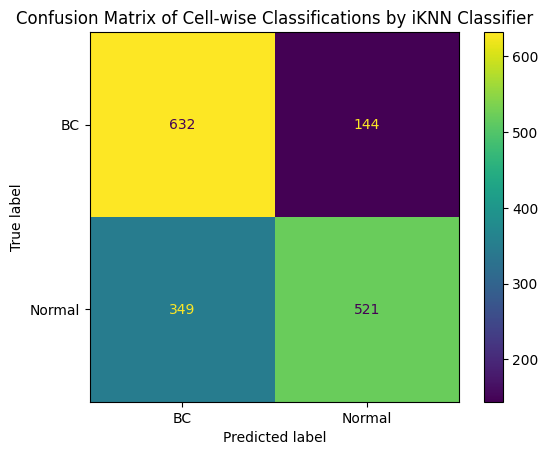

Average Patient Classification Accuracy: 0.8285714285714286
Average BC Patient Classification Accuracy: 1.0
Average Normal Patient Classification Accuracy: 0.7


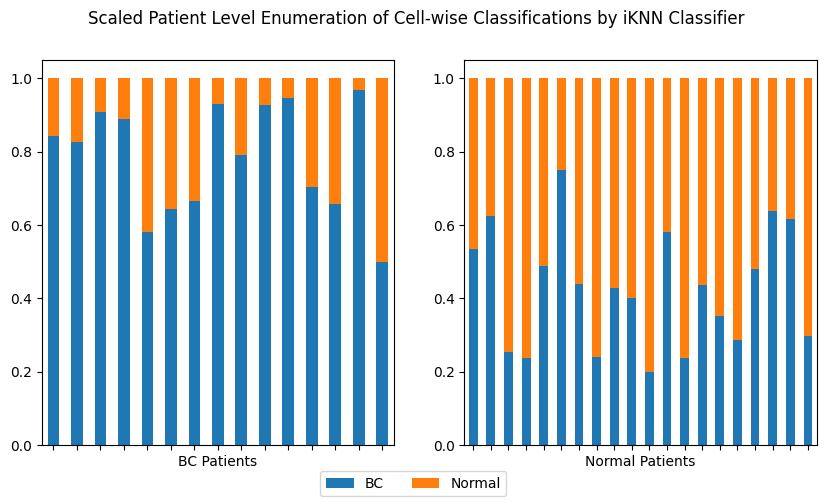

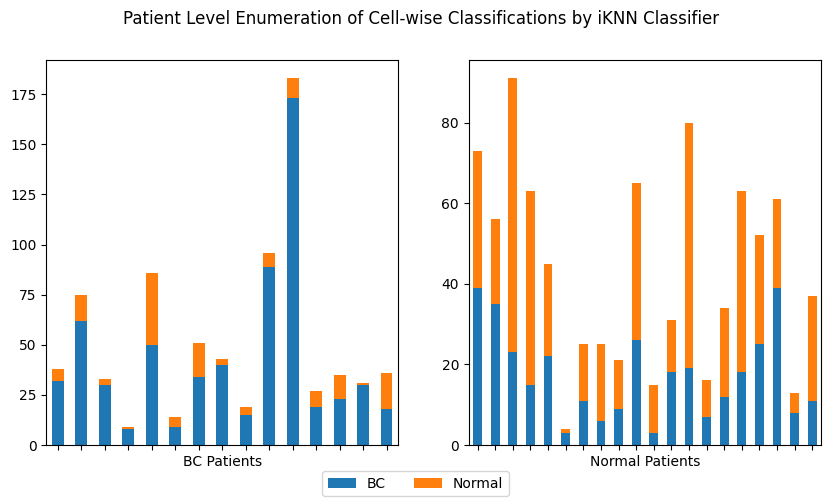

0.8285714285714286

In [ ]:
cell_level_y_pred_analysis(iKNN_george_under, 'iKNN Classifier', *val[0 // 3][0:2])
patient_level_y_pred_analysis(iKNN_george_under, 'iKNN Classifier', X_val, NotX_val)

0.6120245289726272
              precision    recall  f1-score  support
0              0.556377  0.775773  0.648009    776.0
1              0.691489  0.448276  0.543933    870.0
micro avg      0.602673  0.602673  0.602673   1646.0
macro avg      0.623933  0.612025  0.595971   1646.0
weighted avg   0.627791  0.602673  0.592999   1646.0
samples avg    0.602673  0.602673  0.602673   1646.0


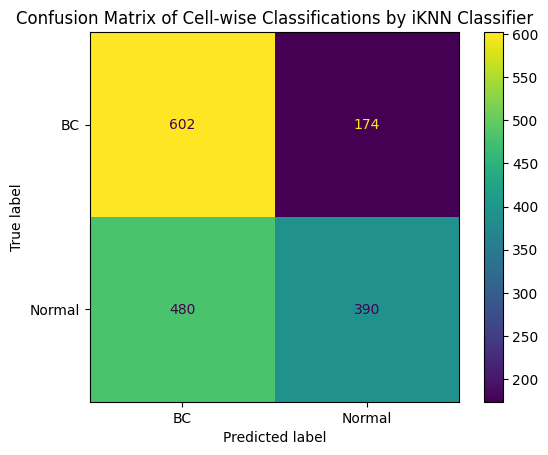

Average Patient Classification Accuracy: 0.6
Average BC Patient Classification Accuracy: 1.0
Average Normal Patient Classification Accuracy: 0.3


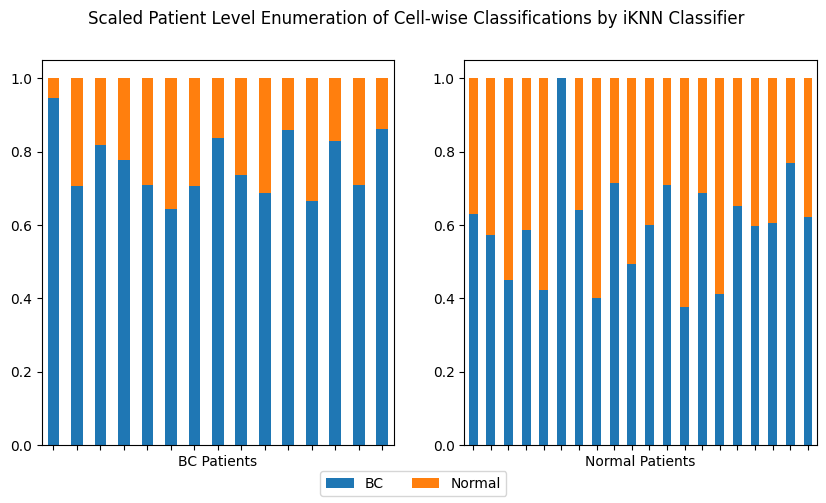

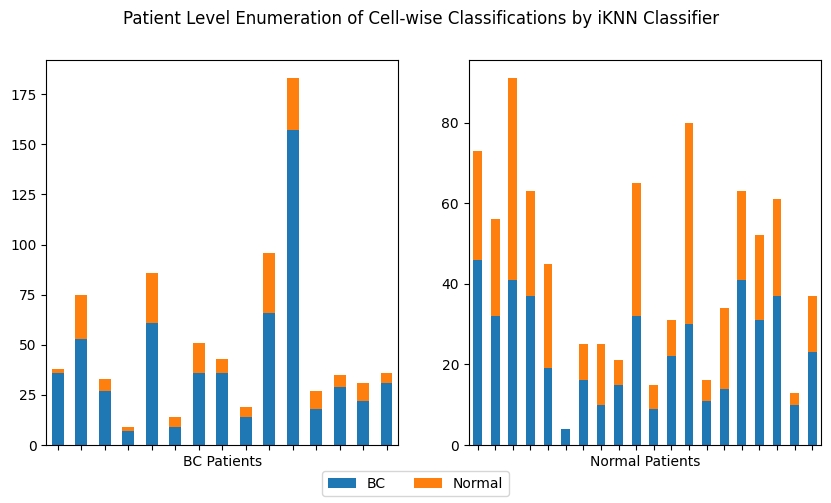

0.6

In [ ]:
cell_level_y_pred_analysis(iKNN_fs_george_under, 'iKNN Classifier', *val[5 // 3][0:2])
patient_level_y_pred_analysis(iKNN_fs_george_under, 'iKNN Classifier', X_fs_val, NotX_val)

TypeError: 'Axes' object is not subscriptable

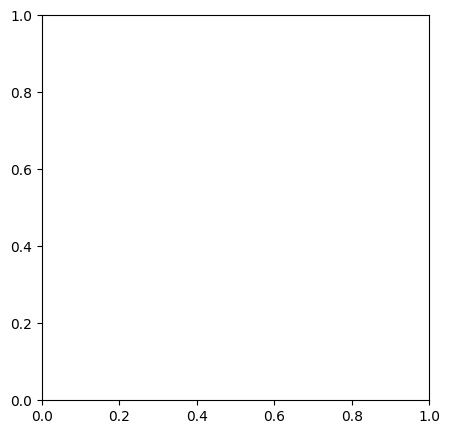

In [ ]:
iKNN_fs_george_under.graph_model(fs_cols)

#### Citation KNN/Falcon

#### Decision Tree

In [ ]:
from sklearn.tree import DecisionTreeClassifier
# Decision Tree
criterion = ['gini', 'entropy']
max_depth = [4, 8, 12]
DT_grid = dict(criterion=criterion, max_depth=max_depth)

In [ ]:
DT_george, DT_george_params = hyp_train(DecisionTreeClassifier(), {'criterion': ['gini'], 'max_depth': [8]}, *train[0])
DT_george_under, DT_george_under_params = hyp_train(DecisionTreeClassifier(), {'criterion': ['gini'], 'max_depth': [8]}, *train[1])
DT_george_over, DT_george_over_params = hyp_train(DecisionTreeClassifier(), {'criterion': ['gini'], 'max_depth': [4]}, *train[2])

Best: 0.724491 using {'criterion': 'gini', 'max_depth': 8}
Best: 0.671663 using {'criterion': 'gini', 'max_depth': 8}
Best: 0.678332 using {'criterion': 'gini', 'max_depth': 4}


In [ ]:
DT_fs_george, DT_fs_george_params = hyp_train(DecisionTreeClassifier(), {'criterion': ['gini'], 'max_depth': [12]}, *train[3])
DT_fs_george_under, DT_fs_george_under_params = hyp_train(DecisionTreeClassifier(), {'criterion': ['gini'], 'max_depth': [4]}, *train[4])
DT_fs_george_over, DT_fs_george_over_params = hyp_train(DecisionTreeClassifier(), {'criterion': ['entropy'], 'max_depth': [4]}, *train[5])

Best: 0.703088 using {'criterion': 'gini', 'max_depth': 12}
Best: 0.655734 using {'criterion': 'gini', 'max_depth': 4}
Best: 0.656822 using {'criterion': 'entropy', 'max_depth': 4}


In [ ]:
multi_DT_george, multi_DT_george_params = hyp_train(DecisionTreeClassifier(), {'criterion': ['gini'], 'max_depth': [8]}, *train[6])
multi_DT_george_under, multi_DT_george_under_params = hyp_train(DecisionTreeClassifier(), {'criterion': ['entropy'], 'max_depth': [12]}, *train[7])
multi_DT_george_over, multi_DT_george_over_params = hyp_train(DecisionTreeClassifier(), {'criterion': ['gini'], 'max_depth': [8]}, *train[8])

Best: 0.560313 using {'criterion': 'gini', 'max_depth': 8}
Best: 0.532511 using {'criterion': 'entropy', 'max_depth': 12}
Best: 0.551213 using {'criterion': 'gini', 'max_depth': 8}


In [ ]:
multi_DT_fs_george, multi_DT_fs_george_params = hyp_train(DecisionTreeClassifier(), {'criterion': ['entropy'], 'max_depth': [8]}, *train[9])
multi_DT_fs_george_under, multi_DT_fs_george_under_params = hyp_train(DecisionTreeClassifier(), {'criterion': ['gini'], 'max_depth': [8]}, *train[10])
multi_DT_fs_george_over, multi_DT_fs_george_over_params = hyp_train(DecisionTreeClassifier(), {'criterion': ['gini'], 'max_depth': [8]}, *train[11])

Best: 0.543899 using {'criterion': 'entropy', 'max_depth': 8}
Best: 0.512670 using {'criterion': 'gini', 'max_depth': 8}
Best: 0.519193 using {'criterion': 'gini', 'max_depth': 8}


In [ ]:
DTs = [DT_george,
       DT_george_under,
       DT_george_over,
       DT_fs_george,
       DT_fs_george_under,
       DT_fs_george_over,
       multi_DT_george,
       multi_DT_george_under,
       multi_DT_george_over,
       multi_DT_fs_george,
       multi_DT_fs_george_under,
       multi_DT_fs_george_over]

#### Random Forest

In [ ]:
from sklearn.ensemble import RandomForestClassifier
# max_features = range(1, 20)
max_features = ['sqrt', 'log2']
# max_depth = [4, 8, 12]
n_estimators = [10, 100, 1000]
RF_grid = dict(max_features=max_features, n_estimators=n_estimators)

In [ ]:
RF_george, RF_george_params = hyp_train(RandomForestClassifier(), {'max_features': ['log2'], 'n_estimators': [1000]}, *train[0])
RF_george_under, RF_george_under_params = hyp_train(RandomForestClassifier(), {'max_features': ['log2'], 'n_estimators': [1000]}, *train[1])
RF_george_over, RF_george_over_params = hyp_train(RandomForestClassifier(), {'max_features': ['sqrt'], 'n_estimators': [1000]}, *train[2])

Best: 0.808434 using {'max_features': 'log2', 'n_estimators': 1000}
Best: 0.747545 using {'max_features': 'log2', 'n_estimators': 1000}
Best: 0.750455 using {'max_features': 'sqrt', 'n_estimators': 1000}


In [ ]:
RF_fs_george, RF_fs_george_params = hyp_train(RandomForestClassifier(), {'max_features': ['log2'], 'n_estimators': [1000]}, *train[3])
RF_fs_george_under, RF_fs_george_under_params = hyp_train(RandomForestClassifier(), {'max_features': ['log2'], 'n_estimators': [1000]}, *train[4])
RF_fs_george_over, RF_fs_george_over_params = hyp_train(RandomForestClassifier(), {'max_features': ['log2'], 'n_estimators': [100]}, *train[5])

Best: 0.790144 using {'max_features': 'log2', 'n_estimators': 1000}
Best: 0.716597 using {'max_features': 'log2', 'n_estimators': 1000}
Best: 0.716990 using {'max_features': 'log2', 'n_estimators': 100}


In [ ]:
multi_RF_george, multi_RF_george_params = hyp_train(RandomForestClassifier(), {'max_features': ['log2'], 'n_estimators': [1000]}, *train[6])
multi_RF_george_under, multi_RF_george_under_params = hyp_train(RandomForestClassifier(), {'max_features': ['log2'], 'n_estimators': [1000]}, *train[7])
multi_RF_george_over, multi_RF_george_over_params = hyp_train(RandomForestClassifier(), {'max_features': ['sqrt'], 'n_estimators': [1000]}, *train[8])

Best: 0.668815 using {'max_features': 'log2', 'n_estimators': 1000}
Best: 0.634383 using {'max_features': 'log2', 'n_estimators': 1000}
Best: 0.646728 using {'max_features': 'sqrt', 'n_estimators': 1000}


In [ ]:
multi_RF_fs_george, multi_RF_fs_george_params = hyp_train(RandomForestClassifier(), {'max_features': ['log2'], 'n_estimators': [1000]}, *train[9])
multi_RF_fs_george_under, multi_RF_fs_george_under_params = hyp_train(RandomForestClassifier(), {'max_features': ['log2'], 'n_estimators': [1000]}, *train[10])
multi_RF_fs_george_over, multi_RF_fs_george_over_params = hyp_train(RandomForestClassifier(), {'max_features': ['log2'], 'n_estimators': [1000]}, *train[11])

Best: 0.648457 using {'max_features': 'log2', 'n_estimators': 1000}
Best: 0.597255 using {'max_features': 'log2', 'n_estimators': 1000}
Best: 0.628420 using {'max_features': 'log2', 'n_estimators': 1000}


In [ ]:
RFs = [RF_george,
       RF_george_under,
       RF_george_over,
       RF_fs_george,
       RF_fs_george_under,
       RF_fs_george_over,
       multi_RF_george,
       multi_RF_george_under,
       multi_RF_george_over,
       multi_RF_fs_george,
       multi_RF_fs_george_under,
       multi_RF_fs_george_over]

#### Adaboost

In [ ]:
from sklearn.ensemble import AdaBoostClassifier
# AdaBoost
n_estimators = [10, 100, 1000]
learning_rate = [0.001, 0.01, 0.1]
AB_grid = dict(n_estimators=n_estimators, learning_rate=learning_rate)

In [ ]:
ABC_george, ABC_george_params = hyp_train(AdaBoostClassifier(), {'learning_rate': [0.01], 'n_estimators': [1000]}, *train[0])
ABC_george_under, ABC_george_under_params = hyp_train(AdaBoostClassifier(), {'learning_rate': [0.01], 'n_estimators': [1000]}, *train[1])
ABC_george_over, ABC_george_over_params = hyp_train(AdaBoostClassifier(), {'learning_rate': [0.1], 'n_estimators': [1000]}, *train[2])

Best: 0.749811 using {'learning_rate': 0.01, 'n_estimators': 1000}
Best: 0.714607 using {'learning_rate': 0.01, 'n_estimators': 1000}
Best: 0.695247 using {'learning_rate': 0.1, 'n_estimators': 1000}


In [ ]:
ABC_fs_george, ABC_fs_george_params = hyp_train(AdaBoostClassifier(), {'learning_rate': [0.01], 'n_estimators': [1000]}, *train[3])
ABC_fs_george_under, ABC_fs_george_under_params = hyp_train(AdaBoostClassifier(), {'learning_rate': [0.01], 'n_estimators': [1000]}, *train[4])
ABC_fs_george_over, ABC_fs_george_over_params = hyp_train(AdaBoostClassifier(), {'learning_rate': [0.01], 'n_estimators': [1000]}, *train[5])

Best: 0.720122 using {'learning_rate': 0.01, 'n_estimators': 1000}
Best: 0.689789 using {'learning_rate': 0.01, 'n_estimators': 1000}
Best: 0.666186 using {'learning_rate': 0.01, 'n_estimators': 1000}


In [ ]:
multi_ABC_george, multi_ABC_george_params = hyp_train(AdaBoostClassifier(), {'learning_rate': [0.01], 'n_estimators': [1000]}, *train[6])
multi_ABC_george_under, multi_ABC_george_under_params = hyp_train(AdaBoostClassifier(), {'learning_rate': [0.1], 'n_estimators': [1000]}, *train[7])
multi_ABC_george_over, multi_ABC_george_over_params = hyp_train(AdaBoostClassifier(), {'learning_rate': [0.1], 'n_estimators': [1000]}, *train[8])

Best: 0.577075 using {'learning_rate': 0.01, 'n_estimators': 1000}
Best: 0.581044 using {'learning_rate': 0.1, 'n_estimators': 1000}
Best: 0.547142 using {'learning_rate': 0.1, 'n_estimators': 1000}


In [ ]:
multi_ABC_fs_george, multi_ABC_fs_george_params = hyp_train(AdaBoostClassifier(), {'learning_rate': [0.1], 'n_estimators': [100]}, *train[9])
multi_ABC_fs_george_under, multi_ABC_fs_george_under_params = hyp_train(AdaBoostClassifier(), {'learning_rate': [0.1], 'n_estimators': [1000]}, *train[10])
multi_ABC_fs_george_over, multi_ABC_fs_george_over_params = hyp_train(AdaBoostClassifier(), {'learning_rate': [0.1], 'n_estimators': [1000]}, *train[11])

Best: 0.568012 using {'learning_rate': 0.1, 'n_estimators': 100}
Best: 0.545512 using {'learning_rate': 0.1, 'n_estimators': 1000}
Best: 0.532890 using {'learning_rate': 0.1, 'n_estimators': 1000}


In [ ]:
ABCs = [ABC_george,
        ABC_george_under,
        ABC_george_over,
        ABC_fs_george,
        ABC_fs_george_under,
        ABC_fs_george_over,
        multi_ABC_george,
        multi_ABC_george_under,
        multi_ABC_george_over,
        multi_ABC_fs_george,
        multi_ABC_fs_george_under,
        multi_ABC_fs_george_over]

#### SVM

In [ ]:
from sklearn.svm import SVC
# Support Vector Machine (SVM)
kernels = ['linear', 'poly', 'rbf', 'sigmoid']
c_values = [100, 10, 1.0, 0.1, 0.001]
SVM_grid = dict(kernel=kernels, C=c_values)

In [ ]:
SVM_george, SVM_george_params = hyp_train(SVC(probability=True), {'C': [1.0], 'kernel': ['rbf']}, *train[0])
SVM_george_under, SVM_george_under_params = hyp_train(SVC(probability=True), {'C': [1.0], 'kernel': ['rbf']}, *train[1])
SVM_george_over, SVM_george_over_params = hyp_train(SVC(probability=True), {'C': [1.0], 'kernel': ['rbf']}, *train[2])

Best: 0.795134 using {'C': 1.0, 'kernel': 'rbf'}
Best: 0.713792 using {'C': 1.0, 'kernel': 'rbf'}
Best: 0.753761 using {'C': 1.0, 'kernel': 'rbf'}


In [ ]:
SVM_fs_george, SVM_fs_george_params = hyp_train(SVC(probability=True), {'C': [1.0], 'kernel': ['rbf']}, *train[3])
SVM_fs_george_under, SVM_fs_george_under_params = hyp_train(SVC(probability=True), {'C': [1.0], 'kernel': ['rbf']}, *train[4])
SVM_fs_george_over, SVM_fs_george_over_params = hyp_train(SVC(probability=True), {'C': [1.0], 'kernel': ['rbf']}, *train[5])

Best: 0.769159 using {'C': 1.0, 'kernel': 'rbf'}
Best: 0.692168 using {'C': 1.0, 'kernel': 'rbf'}
Best: 0.708981 using {'C': 1.0, 'kernel': 'rbf'}


In [ ]:
multi_SVM_george, multi_SVM_george_params = hyp_train(SVC(probability=True), {'C': [1.0], 'kernel': ['rbf']}, *train[6])
multi_SVM_george_under, multi_SVM_george_under_params = hyp_train(SVC(probability=True), {'C': [1.0], 'kernel': ['rbf']}, *train[7])
multi_SVM_george_over, multi_SVM_george_over_params = hyp_train(SVC(probability=True), {'C': [1.0], 'kernel': ['rbf']}, *train[8])

Best: 0.635931 using {'C': 1.0, 'kernel': 'rbf'}
Best: 0.592457 using {'C': 1.0, 'kernel': 'rbf'}
Best: 0.600843 using {'C': 1.0, 'kernel': 'rbf'}


In [ ]:
multi_SVM_fs_george, multi_SVM_fs_george_params = hyp_train(SVC(probability=True), {'C': [10], 'kernel': ['rbf']}, *train[9])
multi_SVM_fs_george_under, multi_SVM_fs_george_under_params = hyp_train(SVC(probability=True), {'C': [10], 'kernel': ['rbf']}, *train[10])
multi_SVM_fs_george_over, multi_SVM_fs_george_over_params = hyp_train(SVC(probability=True), {'C': [10], 'kernel': ['rbf']}, *train[11])

Best: 0.606061 using {'C': 10, 'kernel': 'rbf'}
Best: 0.534100 using {'C': 10, 'kernel': 'rbf'}
Best: 0.551905 using {'C': 10, 'kernel': 'rbf'}


In [ ]:
SVMs = [SVM_george,
        SVM_george_under,
        SVM_george_over,
        SVM_fs_george,
        SVM_fs_george_under,
        SVM_fs_george_over,
        multi_SVM_george,
        multi_SVM_george_under,
        multi_SVM_george_over,
        multi_SVM_fs_george,
        multi_SVM_fs_george_under,
        multi_SVM_fs_george_over]

#### QDA (needs interaction variables)

https://www.datasklr.com/select-classification-methods/linear-and-quadratic-discriminant-analysis

In [ ]:
from sklearn.discriminant_analysis import QuadraticDiscriminantAnalysis
# QuadraticDiscriminantAnalysis
# parameter to be optimized
reg_param = [0.00001, 0.0001, 0.001,0.01, 0.1]
store_covariance = [True, False]
tol = [0.0001, 0.001,0.01, 0.1]
QDA_grid = dict(reg_param=reg_param, store_covariance=store_covariance, tol=tol)

In [ ]:
QDA_george, QDA_george_params = hyp_train(QuadraticDiscriminantAnalysis(), QDA_grid, *train[0])
QDA_george_under, QDA_george_under_params = hyp_train(QuadraticDiscriminantAnalysis(), QDA_grid, *train[1])
QDA_george_over, QDA_george_over_params = hyp_train(QuadraticDiscriminantAnalysis(), QDA_grid, *train[2])

Best: 0.650190 using {'reg_param': 1e-05, 'store_covariance': True, 'tol': 0.0001}
Best: 0.674285 using {'reg_param': 1e-05, 'store_covariance': True, 'tol': 0.0001}
Best: 0.699348 using {'reg_param': 1e-05, 'store_covariance': True, 'tol': 0.0001}


In [ ]:
QDA_fs_george, QDA_fs_george_params = hyp_train(QuadraticDiscriminantAnalysis(), QDA_grid, *train[3])
QDA_fs_george_under, QDA_fs_george_under_params = hyp_train(QuadraticDiscriminantAnalysis(), QDA_grid, *train[4])
QDA_fs_george_over, QDA_fs_george_over_params = hyp_train(QuadraticDiscriminantAnalysis(), QDA_grid, *train[5])

Best: 0.671203 using {'reg_param': 1e-05, 'store_covariance': True, 'tol': 0.0001}
Best: 0.684037 using {'reg_param': 1e-05, 'store_covariance': True, 'tol': 0.0001}
Best: 0.699078 using {'reg_param': 1e-05, 'store_covariance': True, 'tol': 0.0001}


In [ ]:
multi_QDA_george, multi_QDA_george_params = hyp_train(QuadraticDiscriminantAnalysis(), QDA_grid, *train[6])
multi_QDA_george_under, multi_QDA_george_under_params = hyp_train(QuadraticDiscriminantAnalysis(), QDA_grid, *train[7])
multi_QDA_george_over, multi_QDA_george_over_params = hyp_train(QuadraticDiscriminantAnalysis(), QDA_grid, *train[8])

Best: 0.553963 using {'reg_param': 0.0001, 'store_covariance': True, 'tol': 0.0001}
Best: 0.547169 using {'reg_param': 1e-05, 'store_covariance': True, 'tol': 0.0001}
Best: 0.540076 using {'reg_param': 0.0001, 'store_covariance': True, 'tol': 0.0001}


In [ ]:
multi_QDA_fs_george, multi_QDA_fs_george_params = hyp_train(QuadraticDiscriminantAnalysis(), QDA_grid, *train[9])
multi_QDA_fs_george_under, multi_QDA_fs_george_under_params = hyp_train(QuadraticDiscriminantAnalysis(), QDA_grid, *train[10])
multi_QDA_fs_george_over, multi_QDA_fs_george_over_params = hyp_train(QuadraticDiscriminantAnalysis(), QDA_grid, *train[11])

Best: 0.539036 using {'reg_param': 1e-05, 'store_covariance': True, 'tol': 0.0001}
Best: 0.545453 using {'reg_param': 0.001, 'store_covariance': True, 'tol': 0.0001}
Best: 0.509889 using {'reg_param': 1e-05, 'store_covariance': True, 'tol': 0.0001}


In [ ]:
QDAs = [QDA_george,
        QDA_george_under,
        QDA_george_over,
        QDA_fs_george,
        QDA_fs_george_under,
        QDA_fs_george_over,
        multi_QDA_george,
        multi_QDA_george_under,
        multi_QDA_george_over,
        multi_QDA_fs_george,
        multi_QDA_fs_george_under,
        multi_QDA_fs_george_over]

## Model Evaluation

#### Analysis Functions

In [ ]:
from sklearn.metrics import roc_auc_score, classification_report, ConfusionMatrixDisplay

def cell_level_y_pred_analysis(model, model_name, X_test, y_test):
  y_pred = model.predict(X_test)
  y_pred_dummied = pd.get_dummies(y_pred)

  y_test_dummied = pd.get_dummies(y_test)

  roc_score = roc_auc_score(y_test_dummied, y_pred_dummied)
  print(roc_score)

  report = pd.DataFrame.from_dict(classification_report(y_test_dummied, y_pred_dummied, output_dict=True)).transpose()
  print(report)
  # print(report.to_string(index=False, header=False))

  ConfusionMatrixDisplay.from_predictions(y_test, y_pred)
  plt.title(f'Confusion Matrix of Cell-wise Classifications by {model_name}')
  plt.show()

  return roc_score

In [ ]:
def patient_level_y_pred_analysis(model, model_name, X_test, NotX_test, patient_col='slide_id'):
  classes = model.classes_
  num_classes = len(classes)
  y_col_name = 'DX' if num_classes == 2 else 'DX_multi'

  y_pred = model.predict(X_test)
  y_pred_dummied = pd.get_dummies(y_pred)

  columns_of_interest = [y_col_name, patient_col]
  df = NotX_test[columns_of_interest].reset_index(drop=True)
  df.loc[:, 'model_classification'] = y_pred

  dx_df = (df.groupby([patient_col, y_col_name, 'model_classification']).size()/df.groupby([patient_col, y_col_name]).size()).unstack().fillna(0)
  dx_df = dx_df.apply(lambda x: x.idxmax(), axis=1).reset_index()
  dx_df.columns = [patient_col, y_col_name, 'model_classification']
  avg_dx_accuracy = (dx_df['model_classification'] == dx_df[y_col_name]).mean()
  print(f'Average Patient Classification Accuracy: {avg_dx_accuracy}')

  # Making Scaled Enumeration per Patient Bar Plot
  fig, axes = plt.subplots(ncols=num_classes, figsize=(10, 5))
  fig.suptitle(f'Scaled Patient Level Enumeration of Cell-wise Classifications by {model_name}')
  for i in range(num_classes):
    temp_df = df.loc[df[y_col_name] == classes[i]]
    temp_pct_df = (temp_df.groupby([patient_col,'model_classification']).size()/temp_df.groupby([patient_col]).size()).unstack().fillna(0)

    temp_pct_df.plot.bar(stacked=True, ax=axes[i], xlabel=f'{classes[i]} Patients')
    axes[i].get_legend().remove()
    plt.setp(axes[i].get_xticklabels(), visible=False)

    temp_dx_df = temp_pct_df.apply(lambda x: x.idxmax(), axis=1)
    avg_class_dx_accuracy = (temp_dx_df == classes[i]).mean()
    print(f'Average {classes[i]} Patient Classification Accuracy: {avg_class_dx_accuracy}')

  fig.legend(labels=classes, loc="lower center", ncol=num_classes)
  plt.show()

  # Making Raw Enumeration per Patient Bar Plot
  fig, axes = plt.subplots(ncols=num_classes, figsize=(10, 5))
  fig.suptitle(f'Patient Level Enumeration of Cell-wise Classifications by {model_name}')
  for i in range(num_classes):
    temp_df = df.loc[df[y_col_name] == classes[i]]
    temp_bar_df = (temp_df.groupby([patient_col, 'model_classification']).size()).unstack().fillna(0)

    temp_bar_df.plot.bar(stacked=True, ax=axes[i], xlabel=f'{classes[i]} Patients')
    axes[i].get_legend().remove()
    plt.setp(axes[i].get_xticklabels(), visible=False)

  fig.legend(labels=classes, loc="lower center", ncol=num_classes)
  plt.show()

  return avg_dx_accuracy

def patient_level_conf_matrix(model, model_name, X_test, NotX_test, patient_col = 'slide_id'):
  classes = model.classes_
  num_classes = len(classes)
  y_col_name = 'DX' if num_classes == 2 else 'DX_multi'

  y_pred = model.predict(X_test)
  y_pred_dummied = pd.get_dummies(y_pred)
  columns_of_interest = [y_col_name, patient_col]
  df = NotX_test[columns_of_interest].reset_index(drop=True)
  df.loc[:, 'model_classification'] = y_pred

  dx_df = (df.groupby([patient_col, y_col_name, 'model_classification']).size()/df.groupby([patient_col, y_col_name]).size()).unstack().fillna(0)
  dx_df = dx_df.apply(lambda x: x.idxmax(), axis=1).reset_index()
  dx_df.columns = [patient_col, y_col_name, 'model_classification']
  avg_dx_accuracy = (dx_df['model_classification'] == dx_df[y_col_name]).mean()
  print(f'Average Patient Classification Accuracy: {avg_dx_accuracy}')
  ConfusionMatrixDisplay.from_predictions(dx_df[y_col_name], dx_df['model_classification'])
  plt.title(f'Confusion Matrix of Patient Level Classifications by {model_name}')
  plt.show()

In [ ]:
def cell_wandb_recording(model, tags, X_train, y_train, group, X_val, y_val, NotX_val):
  model_name = model.__class__.__name__
  exp_name = 'Cell level ' + tags[0] + ' classifiers using ' + tags[1] + ' trained with ' + tags[2] + ' class balancing'
  run = wandb.init(project='NEvL-Morphometrics-Edition',
                   name=model_name,
                   group=exp_name,
                   tags=tags,
                   config=model.get_params())

  roc_score = cell_level_y_pred_analysis(model, model_name, X_val, y_val)
  wandb.log({'roc_score': roc_score})

  classes = model.classes_
  y_pred = model.predict(X_val)
  y_probas = model.predict_proba(X_val)
  # importances = model.feature_importances_
  # indices = np.argsort(importances)[::-1]

  wandb.sklearn.plot_classifier(model, X_train, X_val, y_train, y_val, y_pred, y_probas, labels=classes, model_name=model_name)
  wandb.finish()

#### Analysis

0.824213473160327
              precision    recall  f1-score  support
0              0.802239  0.831186  0.816456    776.0
1              0.844418  0.817241  0.830607    870.0
micro avg      0.823815  0.823815  0.823815   1646.0
macro avg      0.823328  0.824213  0.823532   1646.0
weighted avg   0.824533  0.823815  0.823936   1646.0
samples avg    0.823815  0.823815  0.823815   1646.0


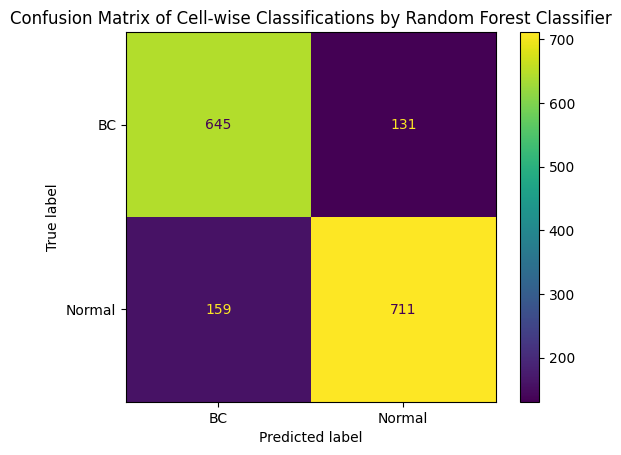

0.824213473160327

In [ ]:
cell_level_y_pred_analysis(RF_george_under, 'Random Forest Classifier', *val[1 // 3][0:2])
patient_level_y_pred_analysis(RF_george_under, 'Random Forest Classifier', X_val, NotX_val)

0.7862861025881189
              precision    recall  f1-score  support
0              0.839223  0.700590  0.763666    678.0
1              0.195335  0.683673  0.303855     98.0
2              0.865672  0.733333  0.794026    870.0
micro avg      0.716889  0.716889  0.716889   1646.0
macro avg      0.633410  0.705866  0.620516   1646.0
weighted avg   0.814866  0.716889  0.752336   1646.0
samples avg    0.716889  0.716889  0.716889   1646.0


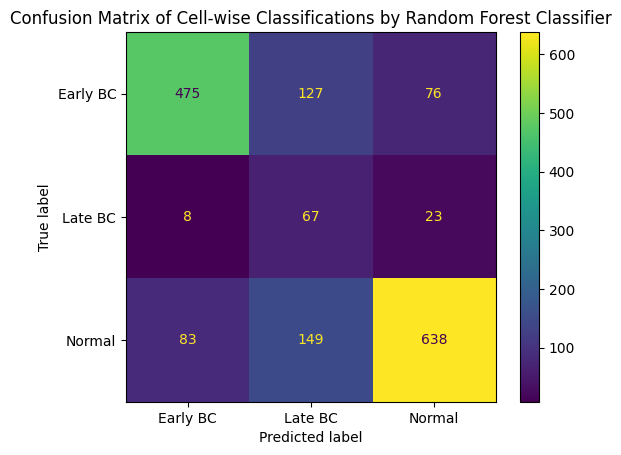

Average Patient Classification Accuracy: 0.8857142857142857
Average Early BC Patient Classification Accuracy: 0.8333333333333334
Average Late BC Patient Classification Accuracy: 1.0
Average Normal Patient Classification Accuracy: 0.9


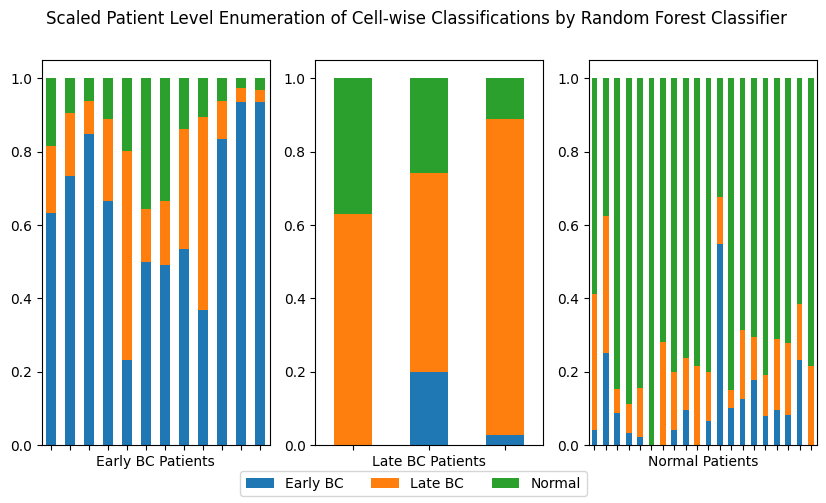

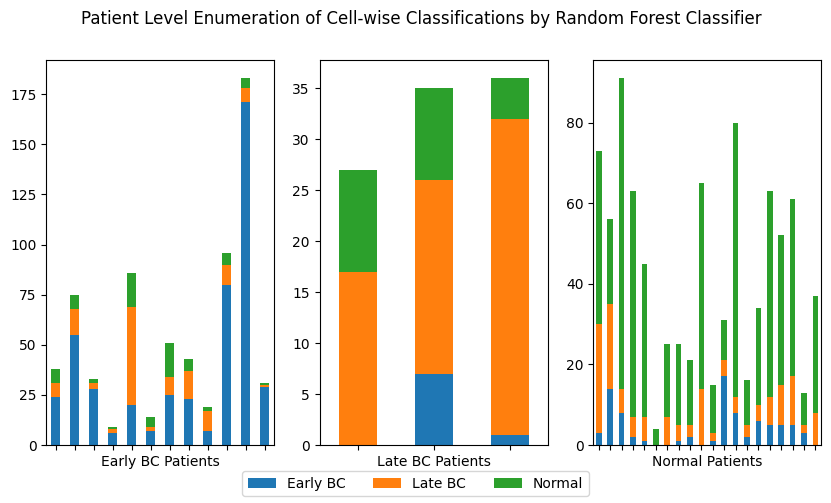

0.8857142857142857

In [ ]:
cell_level_y_pred_analysis(multi_RF_george_under, 'Random Forest Classifier', *val[7 // 3][0:2])
patient_level_y_pred_analysis(multi_RF_george_under, 'Random Forest Classifier', X_val, NotX_val)

0.7130421258442944
              precision    recall  f1-score  support
0              0.788043  0.560567  0.655120    776.0
1              0.688300  0.865517  0.766802    870.0
micro avg      0.721750  0.721750  0.721750   1646.0
macro avg      0.738172  0.713042  0.710961   1646.0
weighted avg   0.735324  0.721750  0.714150   1646.0
samples avg    0.721750  0.721750  0.721750   1646.0


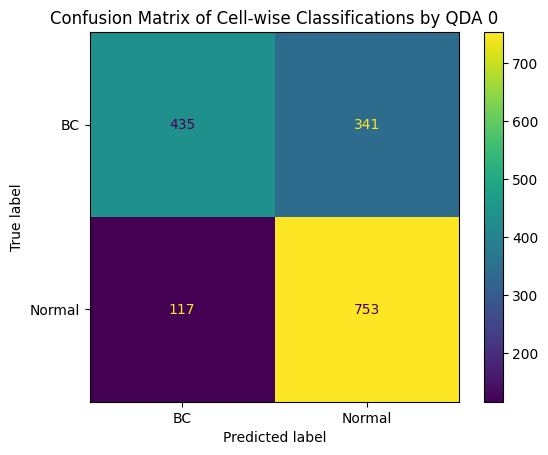

0.707191314136746
              precision    recall  f1-score  support
0              0.795802  0.537371  0.641538    776.0
1              0.680036  0.877011  0.766064    870.0
micro avg      0.716889  0.716889  0.716889   1646.0
macro avg      0.737919  0.707191  0.703801   1646.0
weighted avg   0.734613  0.716889  0.707357   1646.0
samples avg    0.716889  0.716889  0.716889   1646.0


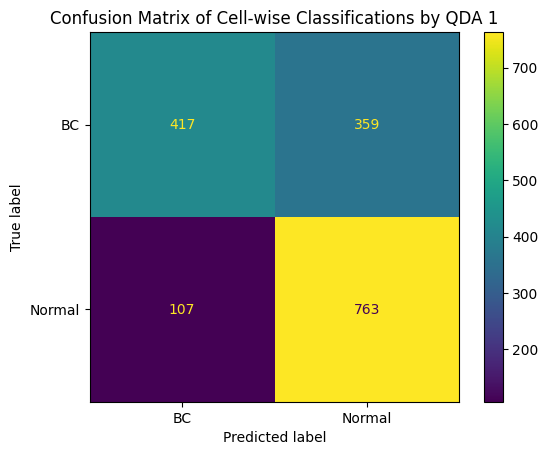

0.7110395189003437
              precision    recall  f1-score  support
0              0.787934  0.555412  0.651550    776.0
1              0.686078  0.866667  0.765871    870.0
micro avg      0.719927  0.719927  0.719927   1646.0
macro avg      0.737006  0.711040  0.708710   1646.0
weighted avg   0.734098  0.719927  0.711975   1646.0
samples avg    0.719927  0.719927  0.719927   1646.0


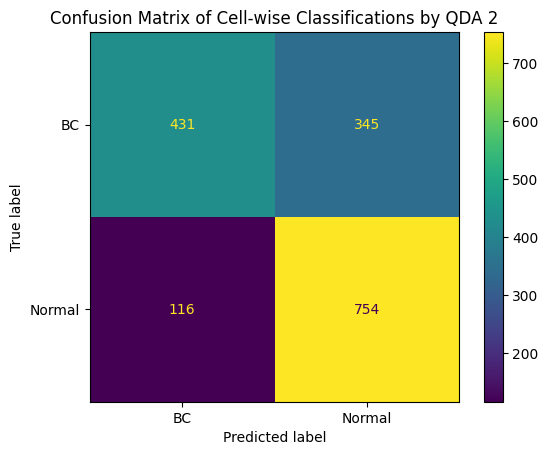

0.7138419836473515
              precision    recall  f1-score  support
0              0.759016  0.596649  0.668110    776.0
1              0.697876  0.831034  0.758657    870.0
micro avg      0.720535  0.720535  0.720535   1646.0
macro avg      0.728446  0.713842  0.713383   1646.0
weighted avg   0.726701  0.720535  0.715969   1646.0
samples avg    0.720535  0.720535  0.720535   1646.0


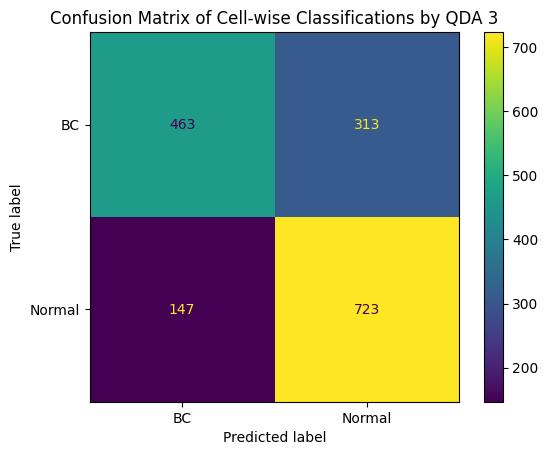

0.710795117904965
              precision    recall  f1-score  support
0              0.772174  0.572165  0.657291    776.0
1              0.690009  0.849425  0.761463    870.0
micro avg      0.718712  0.718712  0.718712   1646.0
macro avg      0.731092  0.710795  0.709377   1646.0
weighted avg   0.728745  0.718712  0.712352   1646.0
samples avg    0.718712  0.718712  0.718712   1646.0


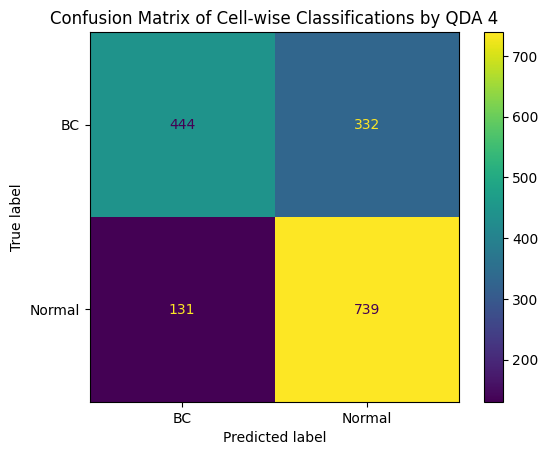

0.7017048820950349
              precision    recall  f1-score  support
0              0.767442  0.552835  0.642697    776.0
1              0.680773  0.850575  0.756260    870.0
micro avg      0.710207  0.710207  0.710207   1646.0
macro avg      0.724107  0.701705  0.699478   1646.0
weighted avg   0.721633  0.710207  0.702721   1646.0
samples avg    0.710207  0.710207  0.710207   1646.0


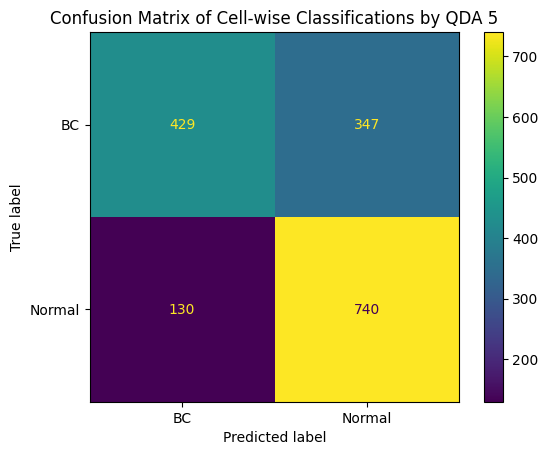

0.6953039334108605
              precision    recall  f1-score  support
0              0.859813  0.542773  0.665461    678.0
1              0.148551  0.418367  0.219251     98.0
2              0.713376  0.772414  0.741722    870.0
micro avg      0.656744  0.656744  0.656744   1646.0
macro avg      0.573913  0.577851  0.542145   1646.0
weighted avg   0.740066  0.656744  0.679202   1646.0
samples avg    0.656744  0.656744  0.656744   1646.0


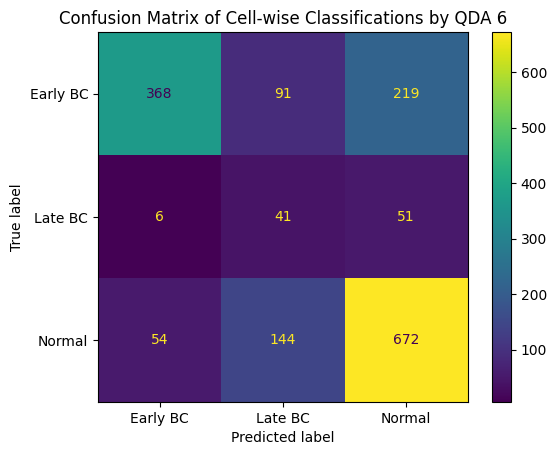

0.6899426943287787
              precision    recall  f1-score  support
0              0.860911  0.529499  0.655708    678.0
1              0.140411  0.418367  0.210256     98.0
2              0.709712  0.764368  0.736027    870.0
micro avg      0.647023  0.647023  0.647023   1646.0
macro avg      0.570345  0.570745  0.533997   1646.0
weighted avg   0.738097  0.647023  0.671639   1646.0
samples avg    0.647023  0.647023  0.647023   1646.0


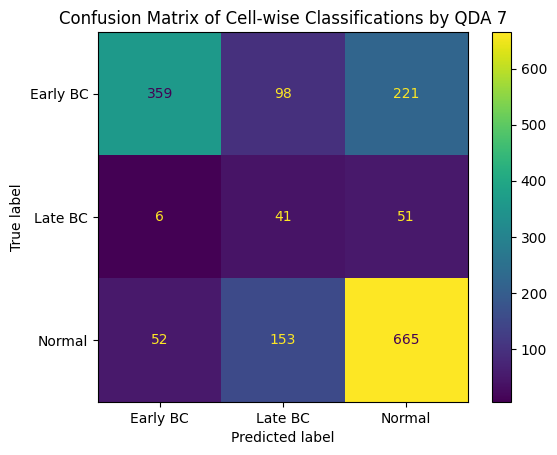

0.6879915052200881
              precision    recall  f1-score  support
0              0.850575  0.545723  0.664870    678.0
1              0.141176  0.367347  0.203966     98.0
2              0.710251  0.780460  0.743702    870.0
micro avg      0.659174  0.659174  0.659174   1646.0
macro avg      0.567334  0.564510  0.537513   1646.0
weighted avg   0.734170  0.659174  0.679095   1646.0
samples avg    0.659174  0.659174  0.659174   1646.0


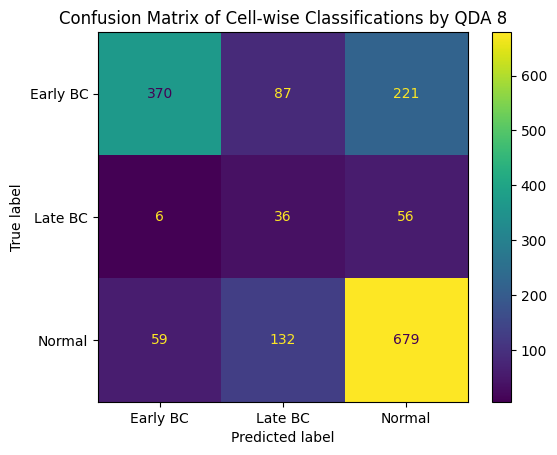

0.6837430916930319
              precision    recall  f1-score  support
0              0.860789  0.547198  0.669071    678.0
1              0.135922  0.428571  0.206388     98.0
2              0.692053  0.720690  0.706081    870.0
micro avg      0.631835  0.631835  0.631835   1646.0
macro avg      0.562921  0.565486  0.527180   1646.0
weighted avg   0.728446  0.631835  0.661086   1646.0
samples avg    0.631835  0.631835  0.631835   1646.0


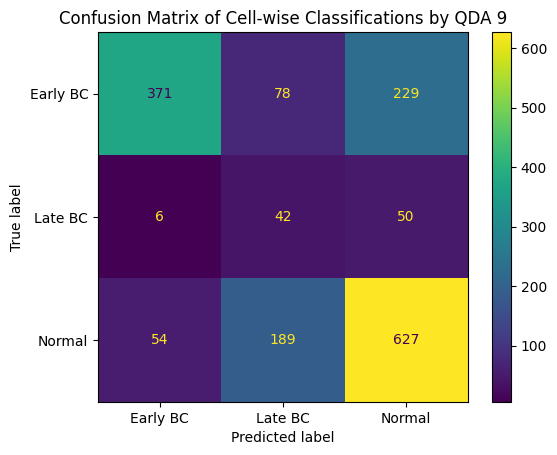

0.6707126742801738
              precision    recall  f1-score  support
0              0.897368  0.502950  0.644612    678.0
1              0.122754  0.418367  0.189815     98.0
2              0.674893  0.722989  0.698113    870.0
micro avg      0.614216  0.614216  0.614216   1646.0
macro avg      0.565005  0.548102  0.510847   1646.0
weighted avg   0.733659  0.614216  0.645813   1646.0
samples avg    0.614216  0.614216  0.614216   1646.0


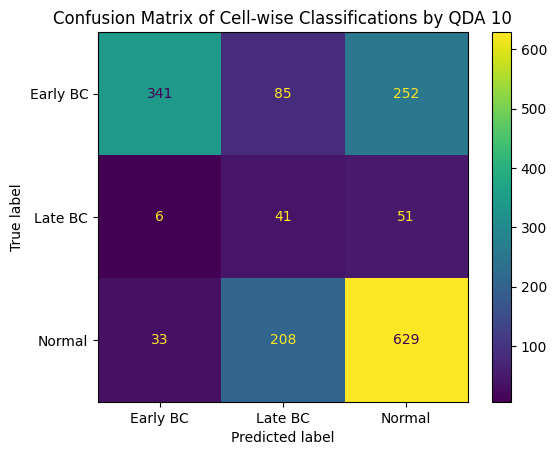

0.686165066577957
              precision    recall  f1-score  support
0              0.881068  0.535398  0.666055    678.0
1              0.136499  0.469388  0.211494     98.0
2              0.688963  0.710345  0.699491    870.0
micro avg      0.623937  0.623937  0.623937   1646.0
macro avg      0.568843  0.571710  0.525680   1646.0
weighted avg   0.735200  0.623937  0.656664   1646.0
samples avg    0.623937  0.623937  0.623937   1646.0


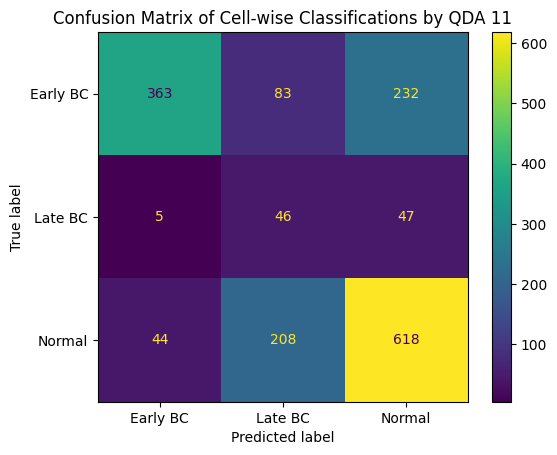

In [ ]:
 for i in range(12):
  cell_level_y_pred_analysis(RFCs[i], f'RFC {i}', *val[i // 3][0:2])

## WANDB Recording

wandb: Currently logged in as: mushran (mushran-usc). Use `wandb login --relogin` to force relogin


0.6084310937314847
              precision    recall  f1-score  support
0              0.536657  0.943299  0.684112    776.0
1              0.843972  0.273563  0.413194    870.0
micro avg      0.589307  0.589307  0.589307   1646.0
macro avg      0.690314  0.608431  0.548653   1646.0
weighted avg   0.699089  0.589307  0.540917   1646.0
samples avg    0.589307  0.589307  0.589307   1646.0


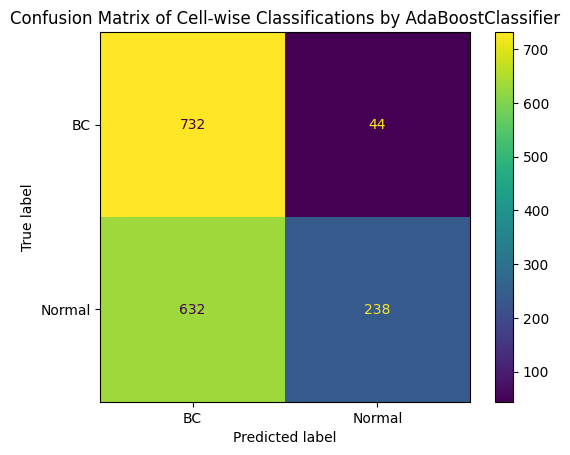

wandb: 
wandb: Plotting AdaBoostClassifier.
/usr/local/lib/python3.10/dist-packages/sklearn/base.py:465: UserWarning: X does not have valid feature names, but AdaBoostClassifier was fitted with feature names
  warnings.warn(
wandb: Logged feature importances.
wandb: Logged confusion matrix.
/usr/local/lib/python3.10/dist-packages/sklearn/base.py:465: UserWarning: X does not have valid feature names, but AdaBoostClassifier was fitted with feature names
  warnings.warn(
wandb: Logged summary metrics.
wandb: Logged class proportions.
/usr/local/lib/python3.10/dist-packages/sklearn/base.py:465: UserWarning: X does not have valid feature names, but AdaBoostClassifier was fitted with feature names
  warnings.warn(
wandb: WARNING This function only supports binary classification at the moment and therefore expects labels to be binary. Skipping calibration curve.
wandb: Logged calibration curve.
wandb: Logged roc curve.
wandb: Logged precision-recall curve.


roc_score,▁
roc_score,0.60843


0.7030779713236166
              precision    recall  f1-score  support
0              0.714286  0.631443  0.670315    776.0
1              0.702083  0.774713  0.736612    870.0
micro avg      0.707169  0.707169  0.707169   1646.0
macro avg      0.708185  0.703078  0.703463   1646.0
weighted avg   0.707836  0.707169  0.705356   1646.0
samples avg    0.707169  0.707169  0.707169   1646.0


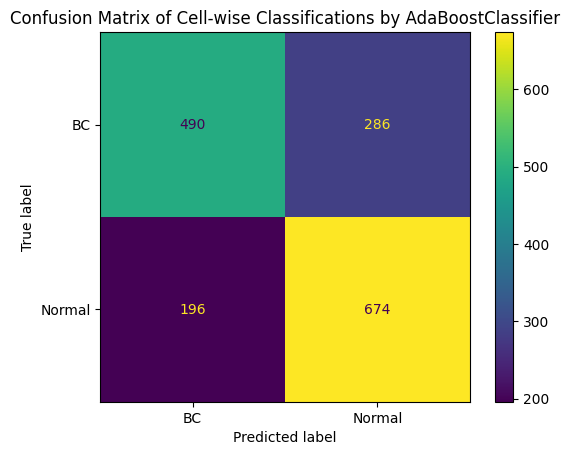

wandb: 
wandb: Plotting AdaBoostClassifier.
/usr/local/lib/python3.10/dist-packages/sklearn/base.py:465: UserWarning: X does not have valid feature names, but AdaBoostClassifier was fitted with feature names
  warnings.warn(
wandb: Logged feature importances.
wandb: Logged confusion matrix.
/usr/local/lib/python3.10/dist-packages/sklearn/base.py:465: UserWarning: X does not have valid feature names, but AdaBoostClassifier was fitted with feature names
  warnings.warn(
wandb: Logged summary metrics.
wandb: Logged class proportions.
/usr/local/lib/python3.10/dist-packages/sklearn/base.py:465: UserWarning: X does not have valid feature names, but AdaBoostClassifier was fitted with feature names
  warnings.warn(
wandb: WARNING This function only supports binary classification at the moment and therefore expects labels to be binary. Skipping calibration curve.
wandb: Logged calibration curve.
wandb: Logged roc curve.
wandb: Logged precision-recall curve.


roc_score,▁
roc_score,0.70308


0.7467679819883872
              precision    recall  f1-score  support
0              0.703322  0.791237  0.744694    776.0
1              0.790427  0.702299  0.743761    870.0
micro avg      0.744228  0.744228  0.744228   1646.0
macro avg      0.746874  0.746768  0.744228   1646.0
weighted avg   0.749362  0.744228  0.744201   1646.0
samples avg    0.744228  0.744228  0.744228   1646.0


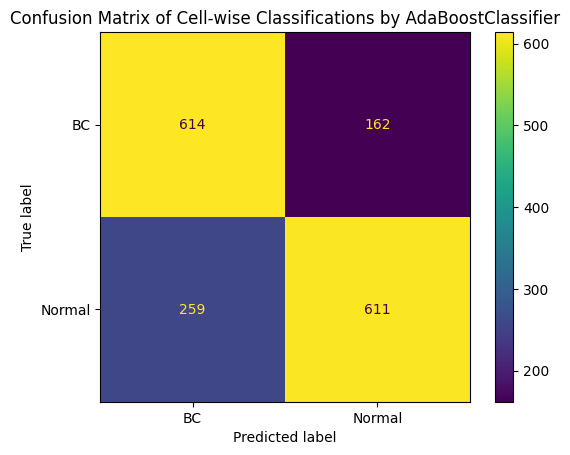

wandb: 
wandb: Plotting AdaBoostClassifier.
/usr/local/lib/python3.10/dist-packages/sklearn/base.py:465: UserWarning: X does not have valid feature names, but AdaBoostClassifier was fitted with feature names
  warnings.warn(
wandb: Logged feature importances.
wandb: Logged confusion matrix.
/usr/local/lib/python3.10/dist-packages/sklearn/base.py:465: UserWarning: X does not have valid feature names, but AdaBoostClassifier was fitted with feature names
  warnings.warn(
wandb: Logged summary metrics.
wandb: Logged class proportions.
/usr/local/lib/python3.10/dist-packages/sklearn/base.py:465: UserWarning: X does not have valid feature names, but AdaBoostClassifier was fitted with feature names
  warnings.warn(
wandb: WARNING This function only supports binary classification at the moment and therefore expects labels to be binary. Skipping calibration curve.
wandb: Logged calibration curve.
wandb: Logged roc curve.
wandb: Logged precision-recall curve.


roc_score,▁
roc_score,0.74677


0.5827082592724256
              precision    recall  f1-score  support
0              0.519462  0.945876  0.670626    776.0
1              0.819742  0.219540  0.346328    870.0
micro avg      0.561968  0.561968  0.561968   1646.0
macro avg      0.669602  0.582708  0.508477   1646.0
weighted avg   0.678177  0.561968  0.499217   1646.0
samples avg    0.561968  0.561968  0.561968   1646.0


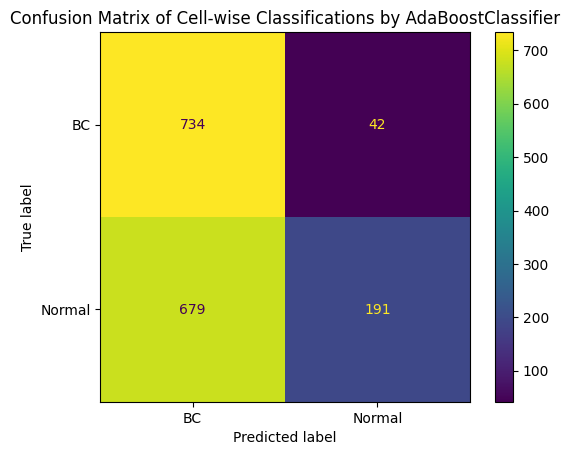

wandb: 
wandb: Plotting AdaBoostClassifier.
/usr/local/lib/python3.10/dist-packages/sklearn/base.py:465: UserWarning: X does not have valid feature names, but AdaBoostClassifier was fitted with feature names
  warnings.warn(
wandb: Logged feature importances.
wandb: Logged confusion matrix.
/usr/local/lib/python3.10/dist-packages/sklearn/base.py:465: UserWarning: X does not have valid feature names, but AdaBoostClassifier was fitted with feature names
  warnings.warn(
wandb: Logged summary metrics.
wandb: Logged class proportions.
/usr/local/lib/python3.10/dist-packages/sklearn/base.py:465: UserWarning: X does not have valid feature names, but AdaBoostClassifier was fitted with feature names
  warnings.warn(
wandb: WARNING This function only supports binary classification at the moment and therefore expects labels to be binary. Skipping calibration curve.
wandb: Logged calibration curve.
wandb: Logged roc curve.
wandb: Logged precision-recall curve.


roc_score,▁
roc_score,0.58271


0.617777580282024
              precision    recall  f1-score  support
0              0.593434  0.605670  0.599490    776.0
1              0.641686  0.629885  0.635731    870.0
micro avg      0.618469  0.618469  0.618469   1646.0
macro avg      0.617560  0.617778  0.617610   1646.0
weighted avg   0.618938  0.618469  0.618645   1646.0
samples avg    0.618469  0.618469  0.618469   1646.0


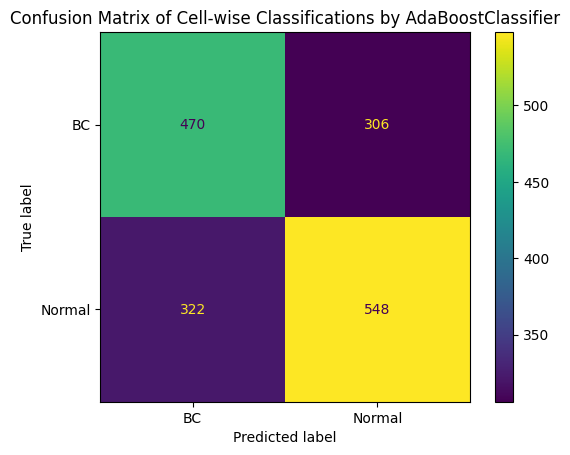

wandb: 
wandb: Plotting AdaBoostClassifier.
/usr/local/lib/python3.10/dist-packages/sklearn/base.py:465: UserWarning: X does not have valid feature names, but AdaBoostClassifier was fitted with feature names
  warnings.warn(
wandb: Logged feature importances.
wandb: Logged confusion matrix.
/usr/local/lib/python3.10/dist-packages/sklearn/base.py:465: UserWarning: X does not have valid feature names, but AdaBoostClassifier was fitted with feature names
  warnings.warn(
wandb: Logged summary metrics.
wandb: Logged class proportions.
/usr/local/lib/python3.10/dist-packages/sklearn/base.py:465: UserWarning: X does not have valid feature names, but AdaBoostClassifier was fitted with feature names
  warnings.warn(
wandb: WARNING This function only supports binary classification at the moment and therefore expects labels to be binary. Skipping calibration curve.
wandb: Logged calibration curve.
wandb: Logged roc curve.
wandb: Logged precision-recall curve.


roc_score,▁
roc_score,0.61778


0.6407305367934589
              precision    recall  f1-score  support
0              0.618321  0.626289  0.622279    776.0
1              0.662791  0.655172  0.658960    870.0
micro avg      0.641555  0.641555  0.641555   1646.0
macro avg      0.640556  0.640731  0.640619   1646.0
weighted avg   0.641825  0.641555  0.641667   1646.0
samples avg    0.641555  0.641555  0.641555   1646.0


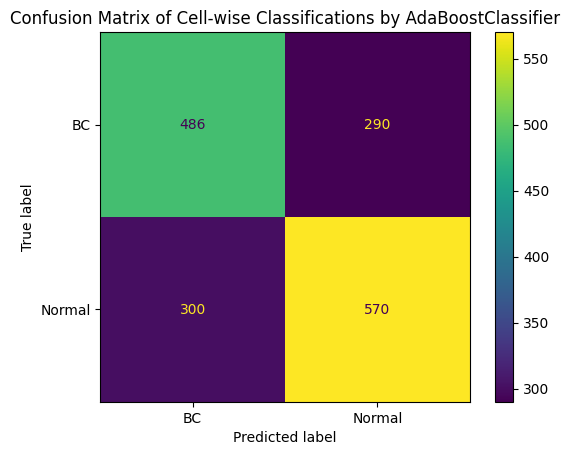

wandb: 
wandb: Plotting AdaBoostClassifier.
/usr/local/lib/python3.10/dist-packages/sklearn/base.py:465: UserWarning: X does not have valid feature names, but AdaBoostClassifier was fitted with feature names
  warnings.warn(
wandb: Logged feature importances.
wandb: Logged confusion matrix.
/usr/local/lib/python3.10/dist-packages/sklearn/base.py:465: UserWarning: X does not have valid feature names, but AdaBoostClassifier was fitted with feature names
  warnings.warn(
wandb: Logged summary metrics.
wandb: Logged class proportions.
/usr/local/lib/python3.10/dist-packages/sklearn/base.py:465: UserWarning: X does not have valid feature names, but AdaBoostClassifier was fitted with feature names
  warnings.warn(
wandb: WARNING This function only supports binary classification at the moment and therefore expects labels to be binary. Skipping calibration curve.
wandb: Logged calibration curve.
wandb: Logged roc curve.
wandb: Logged precision-recall curve.


roc_score,▁
roc_score,0.64073


0.70318531783156
              precision    recall  f1-score  support
0              0.604099  0.825959  0.697819    678.0
1              0.209726  0.704082  0.323185     98.0
2              0.776923  0.348276  0.480952    870.0
micro avg      0.566221  0.566221  0.566221   1646.0
macro avg      0.530250  0.626105  0.500652   1646.0
weighted avg   0.671966  0.566221  0.560888   1646.0
samples avg    0.566221  0.566221  0.566221   1646.0


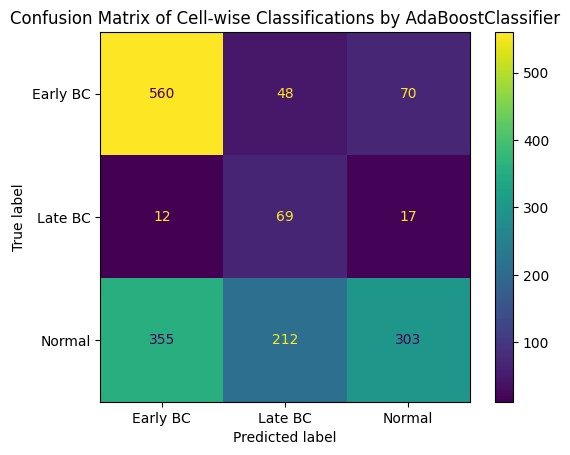

wandb: 
wandb: Plotting AdaBoostClassifier.
/usr/local/lib/python3.10/dist-packages/sklearn/base.py:465: UserWarning: X does not have valid feature names, but AdaBoostClassifier was fitted with feature names
  warnings.warn(
wandb: Logged feature importances.
wandb: Logged confusion matrix.
/usr/local/lib/python3.10/dist-packages/sklearn/base.py:465: UserWarning: X does not have valid feature names, but AdaBoostClassifier was fitted with feature names
  warnings.warn(
wandb: Logged summary metrics.
wandb: Logged class proportions.
/usr/local/lib/python3.10/dist-packages/sklearn/base.py:465: UserWarning: X does not have valid feature names, but AdaBoostClassifier was fitted with feature names
  warnings.warn(
wandb: WARNING This function only supports binary classification at the moment and therefore expects labels to be binary. Skipping calibration curve.
wandb: Logged calibration curve.
wandb: Logged roc curve.
wandb: Logged precision-recall curve.


roc_score,▁
roc_score,0.70319


0.7372807344205614
              precision    recall  f1-score  support
0              0.783626  0.592920  0.675063    678.0
1              0.185185  0.918367  0.308219     98.0
2              0.707883  0.526437  0.603823    870.0
micro avg      0.577157  0.577157  0.577157   1646.0
macro avg      0.558898  0.679241  0.529035   1646.0
weighted avg   0.707961  0.577157  0.615568   1646.0
samples avg    0.577157  0.577157  0.577157   1646.0


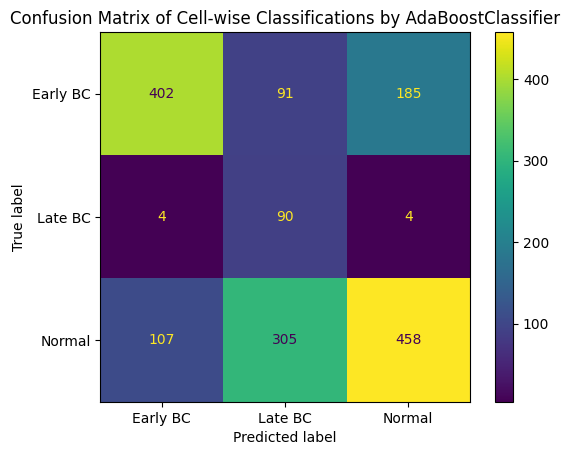

wandb: 
wandb: Plotting AdaBoostClassifier.
/usr/local/lib/python3.10/dist-packages/sklearn/base.py:465: UserWarning: X does not have valid feature names, but AdaBoostClassifier was fitted with feature names
  warnings.warn(
wandb: Logged feature importances.
wandb: Logged confusion matrix.
/usr/local/lib/python3.10/dist-packages/sklearn/base.py:465: UserWarning: X does not have valid feature names, but AdaBoostClassifier was fitted with feature names
  warnings.warn(
wandb: Logged summary metrics.
wandb: Logged class proportions.
/usr/local/lib/python3.10/dist-packages/sklearn/base.py:465: UserWarning: X does not have valid feature names, but AdaBoostClassifier was fitted with feature names
  warnings.warn(
wandb: WARNING This function only supports binary classification at the moment and therefore expects labels to be binary. Skipping calibration curve.
wandb: Logged calibration curve.
wandb: Logged roc curve.
wandb: Logged precision-recall curve.


roc_score,▁
roc_score,0.73728


0.7502544231765059
              precision    recall  f1-score  support
0              0.809249  0.619469  0.701754    678.0
1              0.191489  0.918367  0.316901     98.0
2              0.722983  0.545977  0.622135    870.0
micro avg      0.598420  0.598420  0.598420   1646.0
macro avg      0.574574  0.694604  0.546930   1646.0
weighted avg   0.726872  0.598420  0.636758   1646.0
samples avg    0.598420  0.598420  0.598420   1646.0


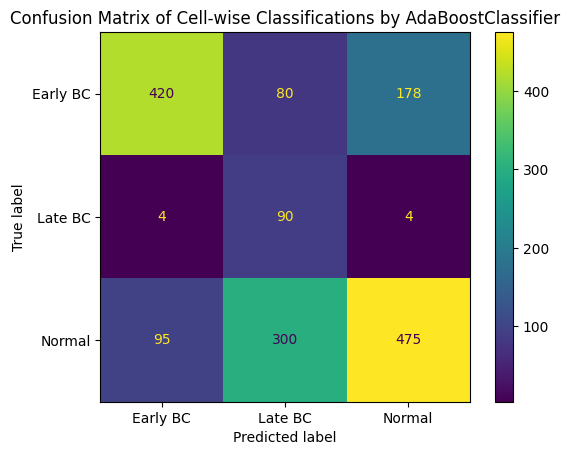

wandb: 
wandb: Plotting AdaBoostClassifier.
/usr/local/lib/python3.10/dist-packages/sklearn/base.py:465: UserWarning: X does not have valid feature names, but AdaBoostClassifier was fitted with feature names
  warnings.warn(
wandb: Logged feature importances.
wandb: Logged confusion matrix.
/usr/local/lib/python3.10/dist-packages/sklearn/base.py:465: UserWarning: X does not have valid feature names, but AdaBoostClassifier was fitted with feature names
  warnings.warn(
wandb: Logged summary metrics.
wandb: Logged class proportions.
/usr/local/lib/python3.10/dist-packages/sklearn/base.py:465: UserWarning: X does not have valid feature names, but AdaBoostClassifier was fitted with feature names
  warnings.warn(
wandb: WARNING This function only supports binary classification at the moment and therefore expects labels to be binary. Skipping calibration curve.
wandb: Logged calibration curve.
wandb: Logged roc curve.
wandb: Logged precision-recall curve.


roc_score,▁
roc_score,0.75025


0.708539784810605
              precision    recall  f1-score  support
0              0.597430  0.823009  0.692308    678.0
1              0.213675  0.765306  0.334076     98.0
2              0.789474  0.327586  0.463038    870.0
micro avg      0.557716  0.557716  0.557716   1646.0
macro avg      0.533526  0.638634  0.496474   1646.0
weighted avg   0.676088  0.557716  0.549798   1646.0
samples avg    0.557716  0.557716  0.557716   1646.0


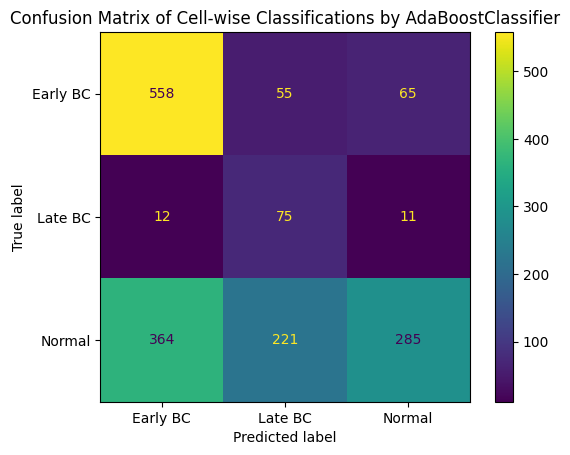

wandb: 
wandb: Plotting AdaBoostClassifier.
/usr/local/lib/python3.10/dist-packages/sklearn/base.py:465: UserWarning: X does not have valid feature names, but AdaBoostClassifier was fitted with feature names
  warnings.warn(
wandb: Logged feature importances.
wandb: Logged confusion matrix.
/usr/local/lib/python3.10/dist-packages/sklearn/base.py:465: UserWarning: X does not have valid feature names, but AdaBoostClassifier was fitted with feature names
  warnings.warn(
wandb: Logged summary metrics.
wandb: Logged class proportions.
/usr/local/lib/python3.10/dist-packages/sklearn/base.py:465: UserWarning: X does not have valid feature names, but AdaBoostClassifier was fitted with feature names
  warnings.warn(
wandb: WARNING This function only supports binary classification at the moment and therefore expects labels to be binary. Skipping calibration curve.
wandb: Logged calibration curve.
wandb: Logged roc curve.
wandb: Logged precision-recall curve.


roc_score,▁
roc_score,0.70854


0.7264307211572776
              precision    recall  f1-score  support
0              0.791749  0.594395  0.679023    678.0
1              0.172211  0.897959  0.288998     98.0
2              0.691693  0.497701  0.578877    870.0
micro avg      0.561361  0.561361  0.561361   1646.0
macro avg      0.551884  0.663352  0.515633   1646.0
weighted avg   0.701978  0.561361  0.602869   1646.0
samples avg    0.561361  0.561361  0.561361   1646.0


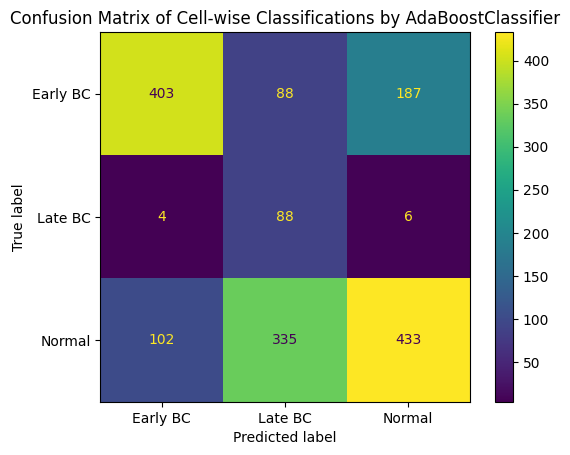

wandb: 
wandb: Plotting AdaBoostClassifier.
/usr/local/lib/python3.10/dist-packages/sklearn/base.py:465: UserWarning: X does not have valid feature names, but AdaBoostClassifier was fitted with feature names
  warnings.warn(
wandb: Logged feature importances.
wandb: Logged confusion matrix.
/usr/local/lib/python3.10/dist-packages/sklearn/base.py:465: UserWarning: X does not have valid feature names, but AdaBoostClassifier was fitted with feature names
  warnings.warn(
wandb: Logged summary metrics.
wandb: Logged class proportions.
/usr/local/lib/python3.10/dist-packages/sklearn/base.py:465: UserWarning: X does not have valid feature names, but AdaBoostClassifier was fitted with feature names
  warnings.warn(
wandb: WARNING This function only supports binary classification at the moment and therefore expects labels to be binary. Skipping calibration curve.
wandb: Logged calibration curve.
wandb: Logged roc curve.
wandb: Logged precision-recall curve.


roc_score,▁
roc_score,0.72643


0.730781226297187
              precision    recall  f1-score  support
0              0.799205  0.592920  0.680779    678.0
1              0.175649  0.897959  0.293823     98.0
2              0.697819  0.514943  0.592593    870.0
micro avg      0.569866  0.569866  0.569866   1646.0
macro avg      0.557558  0.668607  0.522398   1646.0
weighted avg   0.708492  0.569866  0.611129   1646.0
samples avg    0.569866  0.569866  0.569866   1646.0


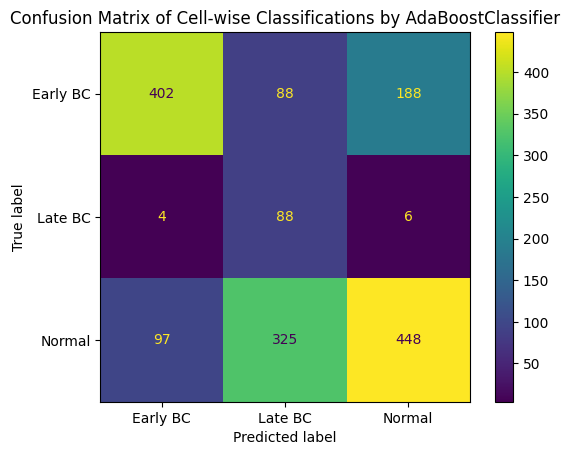

wandb: 
wandb: Plotting AdaBoostClassifier.
/usr/local/lib/python3.10/dist-packages/sklearn/base.py:465: UserWarning: X does not have valid feature names, but AdaBoostClassifier was fitted with feature names
  warnings.warn(
wandb: Logged feature importances.
wandb: Logged confusion matrix.
/usr/local/lib/python3.10/dist-packages/sklearn/base.py:465: UserWarning: X does not have valid feature names, but AdaBoostClassifier was fitted with feature names
  warnings.warn(
wandb: Logged summary metrics.
wandb: Logged class proportions.
/usr/local/lib/python3.10/dist-packages/sklearn/base.py:465: UserWarning: X does not have valid feature names, but AdaBoostClassifier was fitted with feature names
  warnings.warn(
wandb: WARNING This function only supports binary classification at the moment and therefore expects labels to be binary. Skipping calibration curve.
wandb: Logged calibration curve.
wandb: Logged roc curve.
wandb: Logged precision-recall curve.


roc_score,▁
roc_score,0.73078


In [ ]:
# KNNs, DTs, RFs, SVMs,
trained = [ABCs,]
for model_type in trained:
  for i in range(12):
    cell_wandb_recording(model_type[i], tags[i], *train[i], *val[i])

## Gallery Builder

In [ ]:
def gallery_samp(model, model_name, path, X_test, y_test, NotX_test, k):
  y_pred = model.predict(X_test)

  df = pd.DataFrame()
  df[['patient_id', 'tube_id', 'slide_id', 'frame_id', 'cell_id', 'cell_x', 'cell_y']] = NotX_test[['patient_id', 'tube_id', 'slide_id', 'frame_id', 'cell_id', 'cell_x', 'cell_y']]
  df['y_pred'] = y_pred
  df['y_test'] = y_test
  df['correct'] = df['y_pred'] == df['y_test']
  df['TP'] = (df['y_pred'] == 'BC') & (df['y_test'] == 'BC')
  df['TN'] = (df['y_pred'] == 'Normal') & (df['y_test'] == 'Normal')
  df['FP'] = (df['y_pred'] == 'BC') & (df['y_test'] == 'Normal')
  df['FN'] = (df['y_pred'] == 'Normal') & (df['y_test'] == 'BC')

  tp_samp = df.loc[df['TP'] == True].sample(k, replace=False, random_state=random_state)
  tn_samp = df.loc[df['TN'] == True].sample(k, replace=False, random_state=random_state)
  fp_samp = df.loc[df['FP'] == True].sample(k, replace=False, random_state=random_state)
  fn_samp = df.loc[df['FN'] == True].sample(k, replace=False, random_state=random_state)

  tp_samp.to_csv(path + f'{model_name}_{random_state}_{k}_images_TP.csv')
  tn_samp.to_csv(path + f'{model_name}_{random_state}_{k}_images_TN.csv')
  fp_samp.to_csv(path + f'{model_name}_{random_state}_{k}_images_FP.csv')
  fn_samp.to_csv(path + f'{model_name}_{random_state}_{k}_images_FN.csv')

  return tp_samp, fp_samp, tn_samp, fn_samp

In [ ]:
gallery_samp(RF_george_under, 'RF_george_under', '', X_val, y_val, NotX_val, k=25)

(       patient_id tube_id slide_id  frame_id  cell_id  cell_x  cell_y y_pred y_test  correct    TP     TN     FP     FN
 757    BC-OPT-143   0AD65  0AD6502       199     1338    1194     353     BC     BC     True  True  False  False  False
 290     D-OPT-016   05779   057794        89      794     986     668     BC     BC     True  True  False  False  False
 284     D-OPT-016   05779   057793      2203      844      23     136     BC     BC     True  True  False  False  False
 571    BC-OPT-128   0AB1B  0AB1B01      1469     1303     315     563     BC     BC     True  True  False  False  False
 84      D-OPT-011   05268   052683      1399     1286     863     763     BC     BC     True  True  False  False  False
 488     D-OPT-029   07204   072045       616     1513     981     737     BC     BC     True  True  False  False  False
 275     D-OPT-016   05779   057793      1924     1048     317     523     BC     BC     True  True  False  False  False
 147     D-OPT-011   05268   052

## Discovering Morphometric Profiles

#### KNN

In [ ]:
import plotly.graph_objects as go
import numpy as np
from sklearn.datasets import make_moons
from sklearn.model_selection import train_test_split
from sklearn.neighbors import KNeighborsClassifier

mesh_size = .02
margin = 0.25

# Create a mesh grid on which we will run our model
x_min, x_max = X[:, 0].min() - margin, X[:, 0].max() + margin
y_min, y_max = X[:, 1].min() - margin, X[:, 1].max() + margin
xrange = np.arange(x_min, x_max, mesh_size)
yrange = np.arange(y_min, y_max, mesh_size)
xx, yy = np.meshgrid(xrange, yrange)

# Create classifier, run predictions on grid
clf = KNeighborsClassifier(15, weights='uniform')
clf.fit(X, y)
Z = clf.predict_proba(np.c_[xx.ravel(), yy.ravel()])[:, 1]
Z = Z.reshape(xx.shape)

trace_specs = [
    [X_train, y_train, '0', 'Train', 'square'],
    [X_train, y_train, '1', 'Train', 'circle'],
    [X_test, y_test, '0', 'Test', 'square-dot'],
    [X_test, y_test, '1', 'Test', 'circle-dot']
]

fig = go.Figure(data=[
    go.Scatter(
        x=X[y==label, 0], y=X[y==label, 1],
        name=f'{split} Split, Label {label}',
        mode='markers', marker_symbol=marker
    )
    for X, y, label, split, marker in trace_specs
])
fig.update_traces(
    marker_size=12, marker_line_width=1.5,
    marker_color="lightyellow"
)

fig.add_trace(
    go.Contour(
        x=xrange,
        y=yrange,
        z=Z,
        showscale=False,
        colorscale='RdBu',
        opacity=0.4,
        name='Score',
        hoverinfo='skip'
    )
)
fig.show()

NameError: name 'X' is not defined

#### RFC

In [ ]:
!pip install explainerdashboard

In [ ]:
underscored_X_train_under = X_train_under.copy()
underscored_X_train_under.columns = underscored_X_train_under.columns.str.replace('.', '_')

onehot_y_train_under = pd.get_dummies(y_train_under)['BC']

In [ ]:
from sklearn.ensemble import RandomForestClassifier

RF_george_under, RF_george_under_params = hyp_train(RandomForestClassifier(), {'max_features': ['log2'], 'n_estimators': [100]}, underscored_X_train_under, onehot_y_train_under, NotX_train_under['patient_id'])

Best: 0.733452 using {'max_features': 'log2', 'n_estimators': 100}


In [ ]:
from sklearn.ensemble import RandomForestClassifier
stage_X_temp = X_train_under[NotX_train_under['DX_multi'] != 'Normal']
stage_y_temp = NotX_train_under.loc[NotX_train_under['DX_multi'] != 'Normal', ['DX_multi']]
stage_patient_temp = NotX_train_under.loc[NotX_train_under['DX_multi'] != 'Normal', ['patient_id']]
RF_george_under_real, RF_george_under_params_real = hyp_train(RandomForestClassifier(), {'max_features': ['log2'], 'n_estimators': [100]}, stage_X_temp, np.ravel(stage_y_temp), np.ravel(stage_patient_temp))

Best: 0.731431 using {'max_features': 'log2', 'n_estimators': 100}


Best: 0.744208 using {'max_features': 'log2', 'n_estimators': 100}
0.8203297191610381
              precision    recall  f1-score  support
0              0.793865  0.833763  0.813325    776.0
1              0.844765  0.806897  0.825397    870.0
micro avg      0.819563  0.819563  0.819563   1646.0
macro avg      0.819315  0.820330  0.819361   1646.0
weighted avg   0.820769  0.819563  0.819706   1646.0
samples avg    0.819563  0.819563  0.819563   1646.0


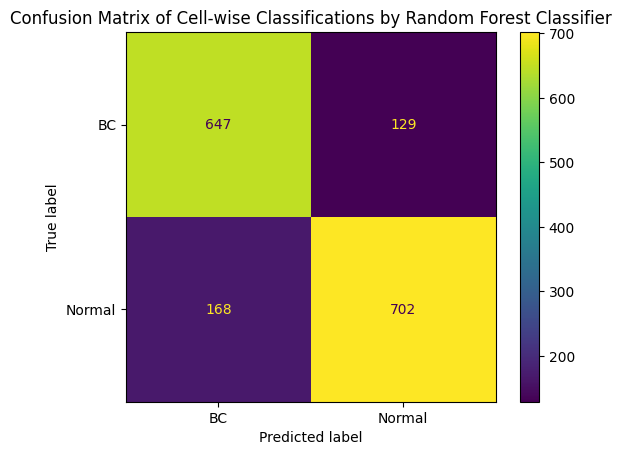

Average Patient Classification Accuracy: 0.9264705882352942
Average BC Patient Classification Accuracy: 0.9666666666666667
Average Normal Patient Classification Accuracy: 0.8947368421052632


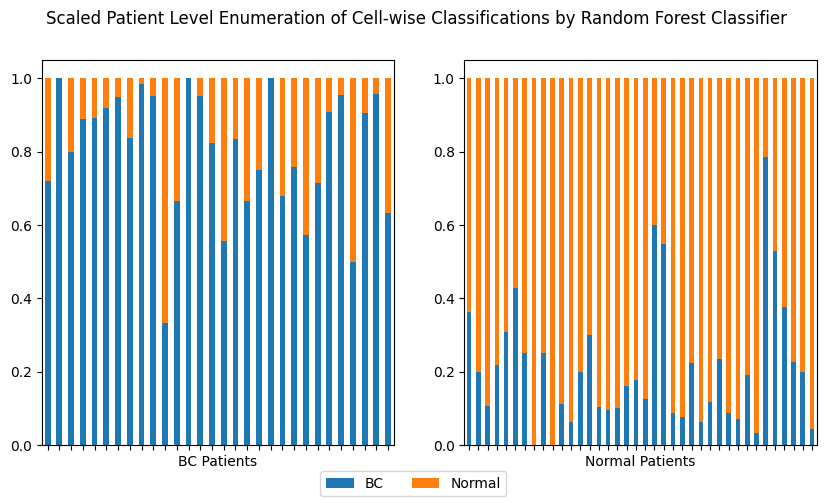

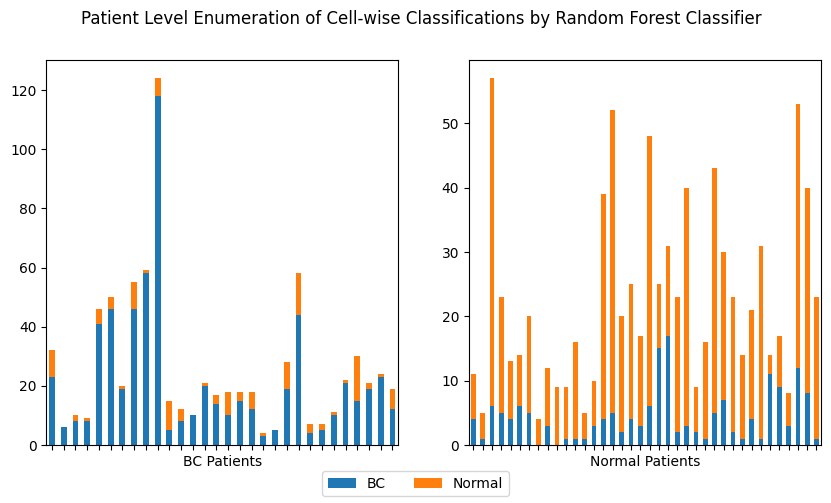

Average Patient Classification Accuracy: 0.9264705882352942


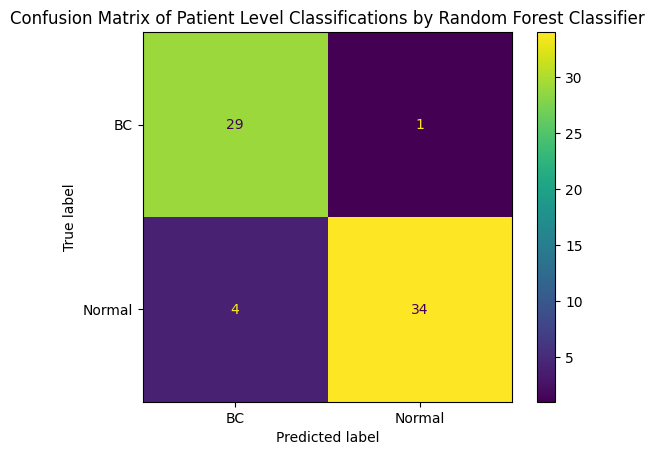

In [ ]:
from sklearn.ensemble import RandomForestClassifier
RF_george_under_real, RF_george_under_params_real = hyp_train(RandomForestClassifier(), {'max_features': ['log2'], 'n_estimators': [100]}, X_train_under, y_train_under, NotX_train_under['patient_id'])
cell_level_y_pred_analysis(RF_george_under_real, 'Random Forest Classifier', X_val, y_val)
patient_level_y_pred_analysis(RF_george_under_real, 'Random Forest Classifier', X_val, NotX_val)
patient_level_conf_matrix(RF_george_under_real, 'Random Forest Classifier', X_val, NotX_val)

0.7426404189994582
              precision    recall  f1-score  support
0              0.940514  0.862832  0.900000    678.0
1              0.396104  0.622449  0.484127     98.0
micro avg      0.832474  0.832474  0.832474    776.0
macro avg      0.668309  0.742640  0.692063    776.0
weighted avg   0.871762  0.832474  0.847480    776.0
samples avg    0.832474  0.832474  0.832474    776.0


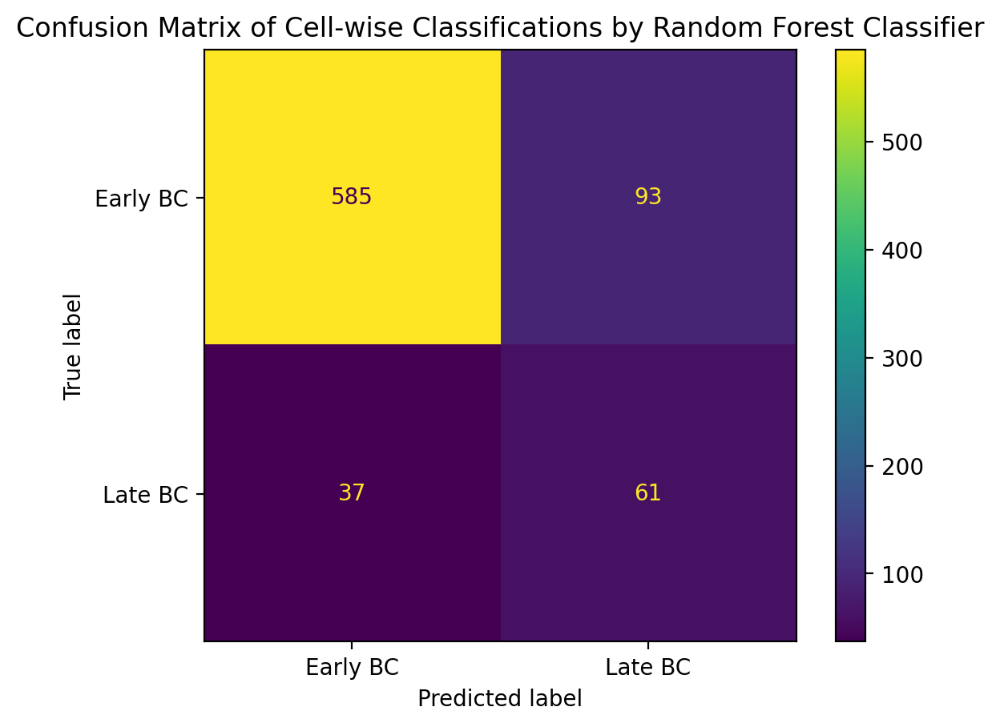

Average Patient Classification Accuracy: 0.9
Average Early BC Patient Classification Accuracy: 0.9583333333333334
Average Late BC Patient Classification Accuracy: 0.6666666666666666


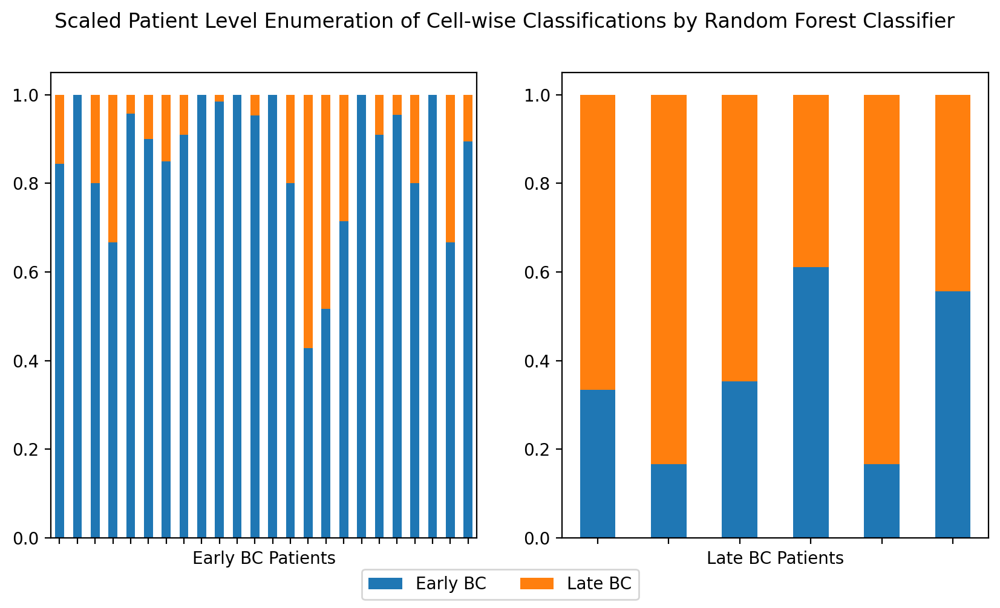

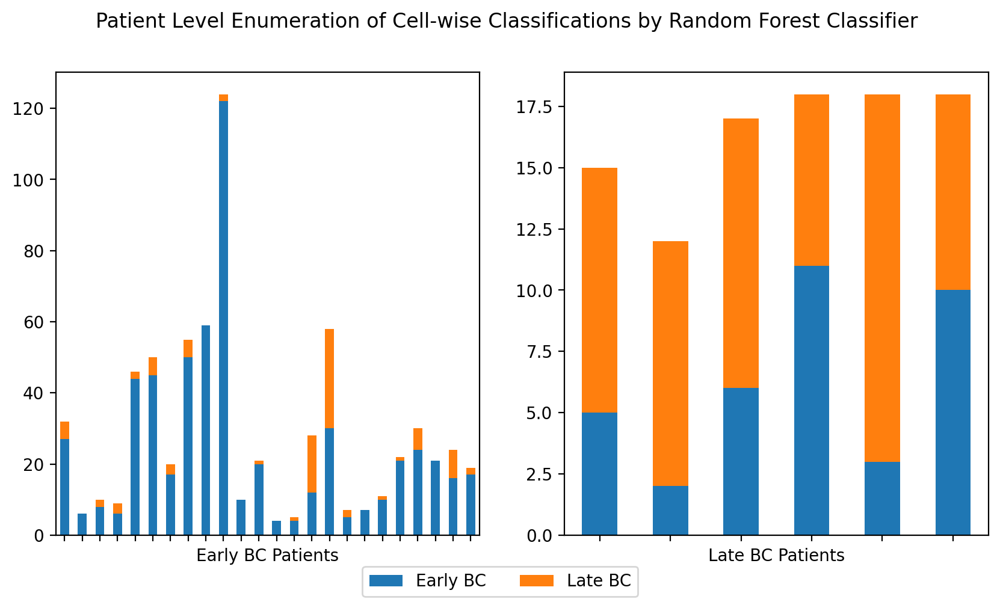

Average Patient Classification Accuracy: 0.9


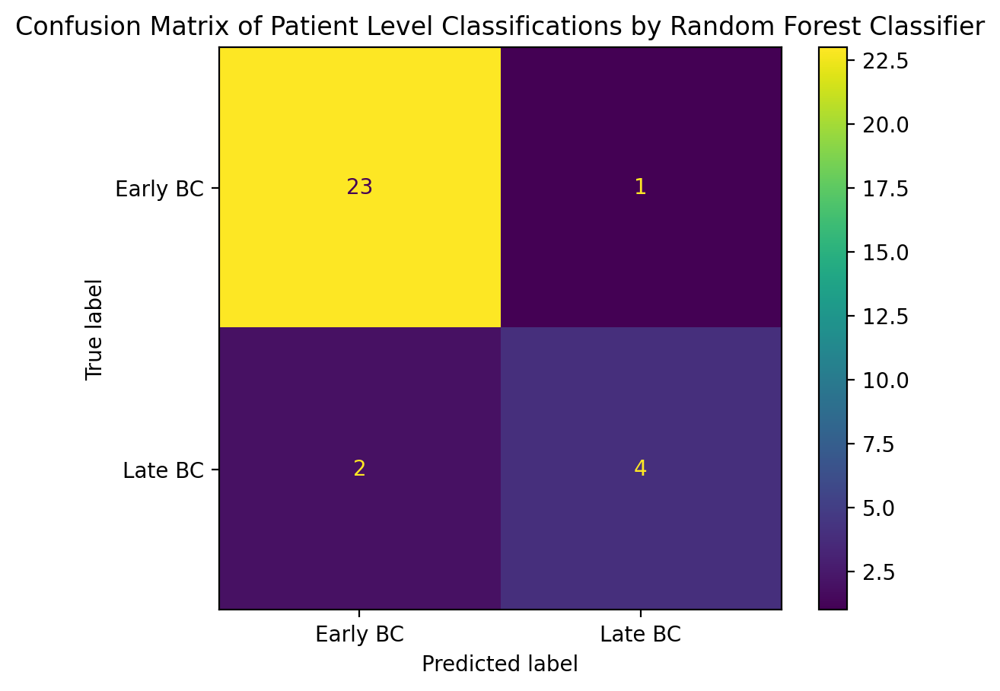

In [ ]:
stage_X_temp_val = X_val[NotX_val['DX_multi'] != 'Normal']
stage_y_temp_val = NotX_val.loc[NotX_val['DX_multi'] != 'Normal', ['DX_multi']].rename(columns={'DX_multi': 'DX'})
stage_patient_temp_val = NotX_val.loc[NotX_val['DX_multi'] != 'Normal', ['slide_id', 'DX_multi']].rename(columns={'DX_multi': 'DX'})

cell_level_y_pred_analysis(RF_george_under_real, 'Random Forest Classifier', stage_X_temp_val, stage_y_temp_val)
patient_level_y_pred_analysis(RF_george_under_real, 'Random Forest Classifier', stage_X_temp_val, stage_patient_temp_val)
patient_level_conf_matrix(RF_george_under_real, 'Random Forest Classifier', stage_X_temp_val, stage_patient_temp_val)

In [ ]:
!pip install xgboost

In [ ]:
from xgboost import XGBClassifier

XGB_george_under, XGB_george_under_params = hyp_train(XGBClassifier(), {}, underscored_X_train_under, onehot_y_train_under, NotX_train_under['patient_id'])

Best: 0.742544 using {}


0.8091494845360825
              precision    recall  f1-score  support
0              0.831541  0.800000  0.815466    870.0
1              0.784920  0.818299  0.801262    776.0
micro avg      0.808627  0.808627  0.808627   1646.0
macro avg      0.808230  0.809149  0.808364   1646.0
weighted avg   0.809562  0.808627  0.808769   1646.0
samples avg    0.808627  0.808627  0.808627   1646.0


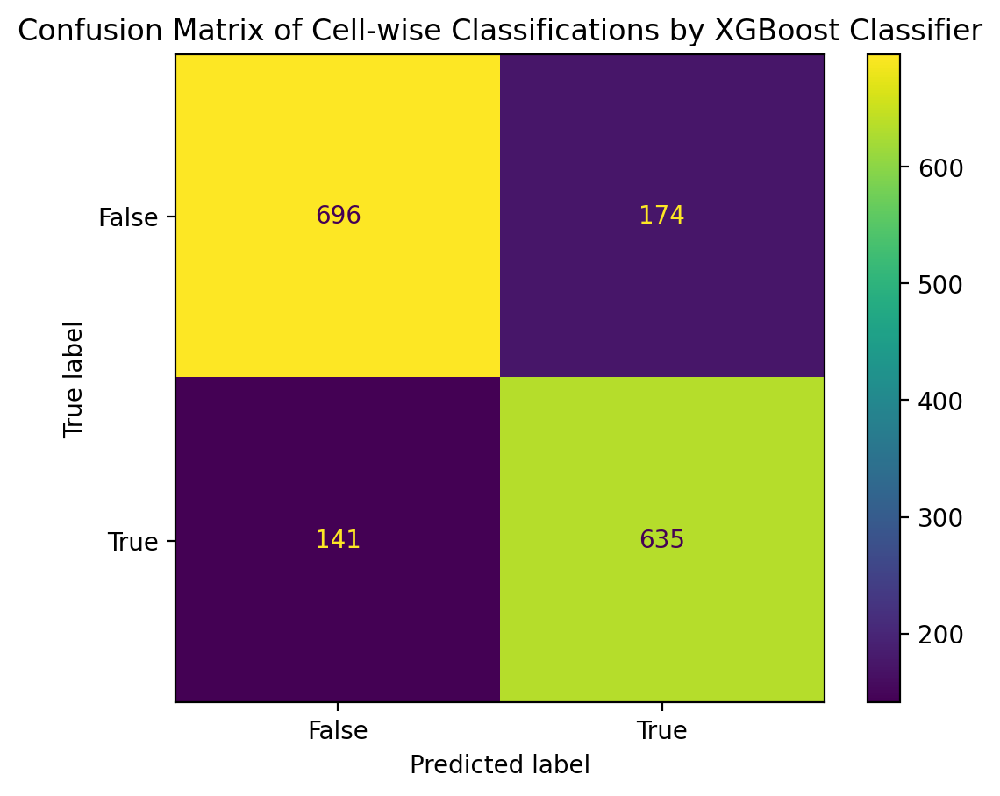

Average Patient Classification Accuracy: 0.8970588235294118
Average 0 Patient Classification Accuracy: 0.9210526315789473
Average 1 Patient Classification Accuracy: 0.8666666666666667


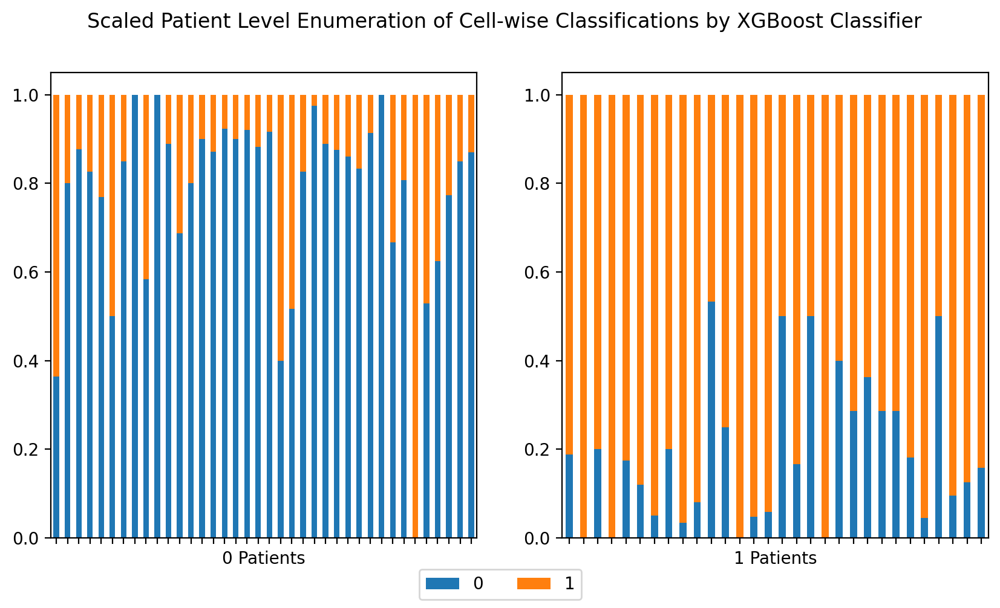

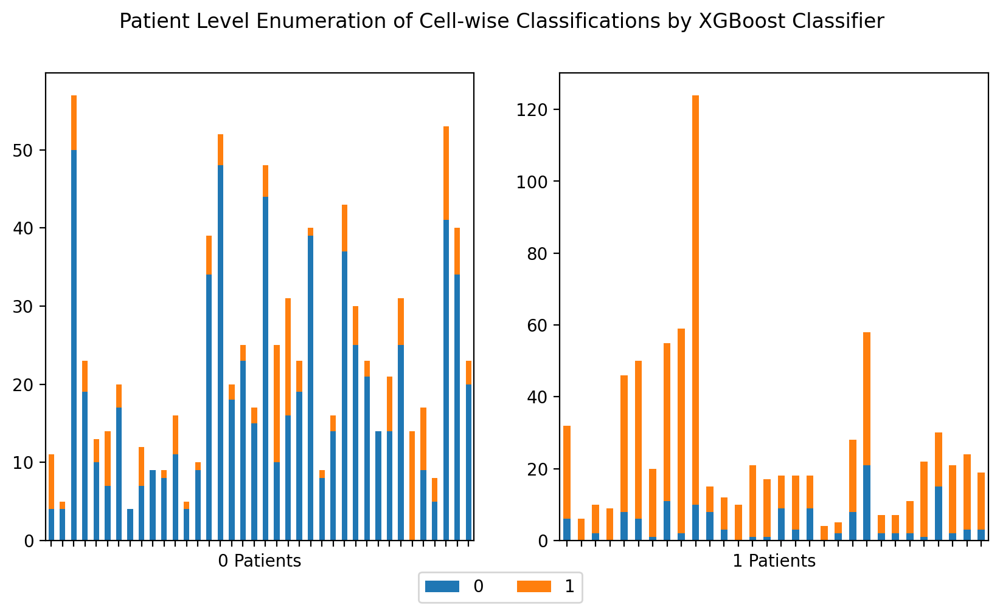

Average Patient Classification Accuracy: 0.8970588235294118


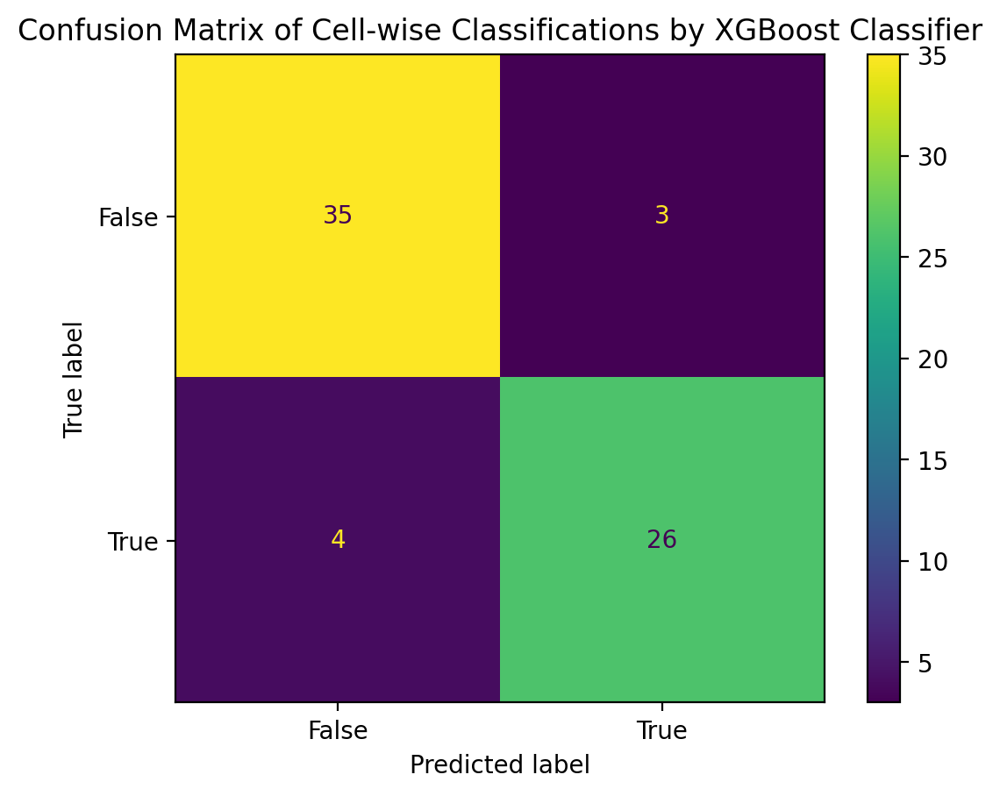

In [ ]:
underscored_X_val = X_val.copy()
underscored_X_val.columns = underscored_X_val.columns.str.replace('.', '_')

onehot_y_val = pd.get_dummies(y_val)['BC']

onehot_NotX_val = pd.DataFrame(NotX_val['slide_id'], columns=['slide_id'])
onehot_NotX_val['DX'] = pd.get_dummies(NotX_val['DX'])['BC']

cell_level_y_pred_analysis(XGB_george_under, 'XGBoost Classifier', underscored_X_val, onehot_y_val)
patient_level_y_pred_analysis(XGB_george_under, 'XGBoost Classifier', underscored_X_val, onehot_NotX_val)
patient_level_conf_matrix(XGB_george_under, 'XGBoost Classifier', underscored_X_val, onehot_NotX_val)

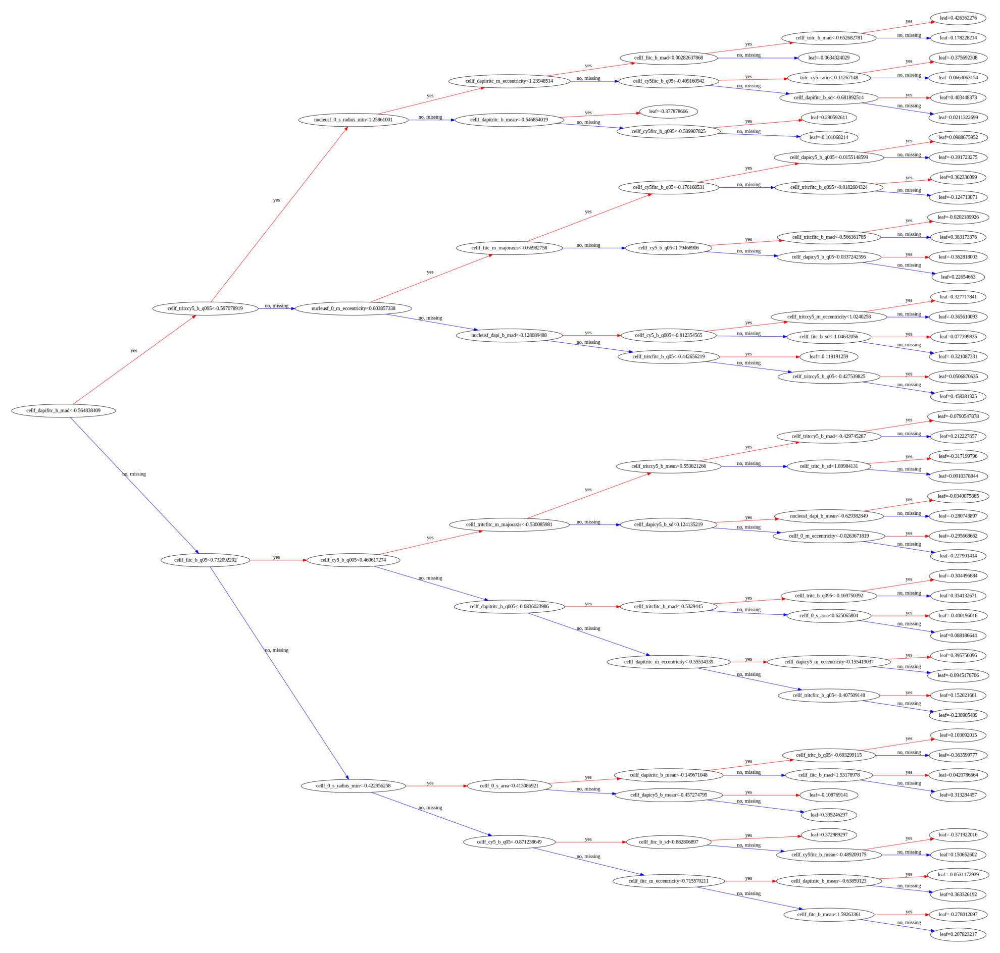

'xgboost_tree.png'

<Figure size 640x480 with 0 Axes>

In [ ]:
from xgboost import plot_tree, to_graphviz

plot_tree(XGB_george_under, num_trees=1, rankdir='LR')
plt.gcf().set_size_inches(20, 12)
plt.show()
plt.savefig("temp.png", dpi=300)
dot = to_graphviz(XGB_george_under, num_trees=0, rankdir='LR')
dot.render("xgboost_tree", format="png")

In [ ]:
!pip install supertree

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 321.3/321.3 kB 4.9 MB/s eta 0:00:00
  Preparing metadata (setup.py) ... done
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 1.6/1.6 MB 29.5 MB/s eta 0:00:00
  Created wheel for supertree: filename=supertree-0.5.2-py3-none-any.whl size=223775 sha256=071165f1490f16b908de00e9d9e72196ec7355692208d92e92422cd2773e2e17
  Stored in directory: /root/.cache/pip/wheels/35/c0/13/d8e959b527b74dd993a490bd80d756bab11ee3bc167f339a2f
Successfully built supertree


In [ ]:
from supertree import SuperTree

st = SuperTree(
    XGB_george_under,
    underscored_X_val,
    onehot_y_val
)
# Visualize the tree
st.show_tree(which_tree=1)

In [ ]:
st.save_html("output",3)

HTML saved to output.html


In [ ]:
import sys
import os

In [ ]:
%config InlineBackend.figure_format = 'retina' # Make visualizations look good
#%config InlineBackend.figure_format = 'svg'
%matplotlib inline

if 'google.colab' in sys.modules:
  !pip install -q dtreeviz

In [ ]:
import xgboost as xgb
from xgboost import plot_importance, plot_tree, plotting

import dtreeviz
import graphviz
import matplotlib.pyplot as plt
from matplotlib.pylab import rcParams

import pandas as pd
import numpy as np

random_state = 42 # get reproducible trees

In [ ]:
viz_model = dtreeviz.model(XGB_george_under, tree_index=1,
                           X_train=underscored_X_train_under, y_train=onehot_y_train_under,
                           feature_names=underscored_X_train_under.columns,
                           target_name='DX', class_names=["BC", "Normal"])

In [ ]:
viz_model.view(fancy=False)

AttributeError: 'Index' object has no attribute 'index'

In [ ]:
!pip install catboost

   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 98.7/98.7 MB 9.1 MB/s eta 0:00:00


In [ ]:
from catboost import CatBoostClassifier, Pool

CatBoost_george_under, CatBoost_george_under_params = hyp_train(CatBoostClassifier(), {'iterations': [100], 'depth': [3], 'learning_rate': [0.1]}, underscored_X_train_under, onehot_y_train_under, NotX_train_under['patient_id'])

0:	learn: 0.6752821	total: 61.2ms	remaining: 6.06s
1:	learn: 0.6589558	total: 71.3ms	remaining: 3.49s
2:	learn: 0.6455253	total: 79.5ms	remaining: 2.57s
3:	learn: 0.6346934	total: 88.9ms	remaining: 2.13s
4:	learn: 0.6284180	total: 97.4ms	remaining: 1.85s
5:	learn: 0.6210197	total: 106ms	remaining: 1.65s
6:	learn: 0.6126483	total: 115ms	remaining: 1.53s
7:	learn: 0.6055878	total: 123ms	remaining: 1.42s
8:	learn: 0.5978894	total: 133ms	remaining: 1.34s
9:	learn: 0.5920145	total: 143ms	remaining: 1.28s
10:	learn: 0.5871702	total: 152ms	remaining: 1.23s
11:	learn: 0.5819209	total: 161ms	remaining: 1.18s
12:	learn: 0.5767119	total: 170ms	remaining: 1.14s
13:	learn: 0.5729037	total: 179ms	remaining: 1.1s
14:	learn: 0.5664335	total: 196ms	remaining: 1.11s
15:	learn: 0.5612061	total: 207ms	remaining: 1.08s
16:	learn: 0.5573558	total: 217ms	remaining: 1.06s
17:	learn: 0.5528314	total: 231ms	remaining: 1.05s
18:	learn: 0.5492439	total: 252ms	remaining: 1.07s
19:	learn: 0.5454578	total: 267ms	rem

In [ ]:
import shap

underscored_X_val = X_val.copy()
underscored_X_val.columns = underscored_X_val.columns.str.replace('.', '_')

pred = XGB_george_under.predict(underscored_X_val, output_margin=True)

explainer = shap.TreeExplainer(XGB_george_under)
explanation = explainer(underscored_X_val)

shap_values = explanation.values
# make sure the SHAP values add up to marginal predictions
np.abs(shap_values.sum(axis=1) + explanation.base_values - pred).max()

3.8146973e-06

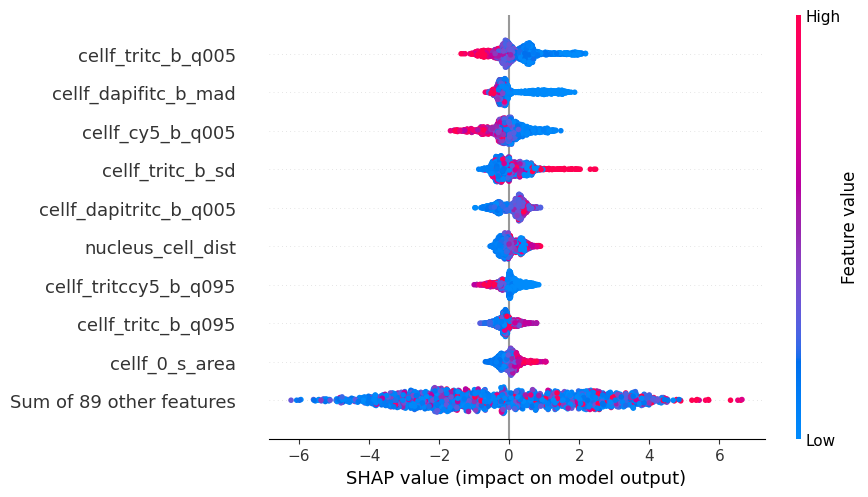

In [ ]:
shap.plots.beeswarm(explanation)

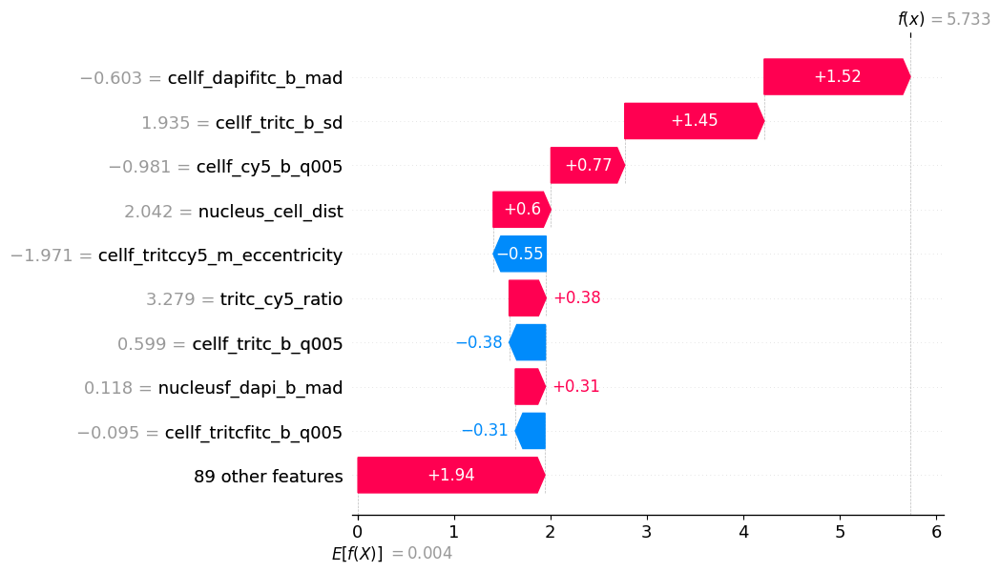

In [ ]:
shap.plots.waterfall(explanation[0])

In [ ]:
shap.initjs()
shap.plots.force(explanation[0])

In [ ]:
shap.initjs()
shap.plots.force(explanation)

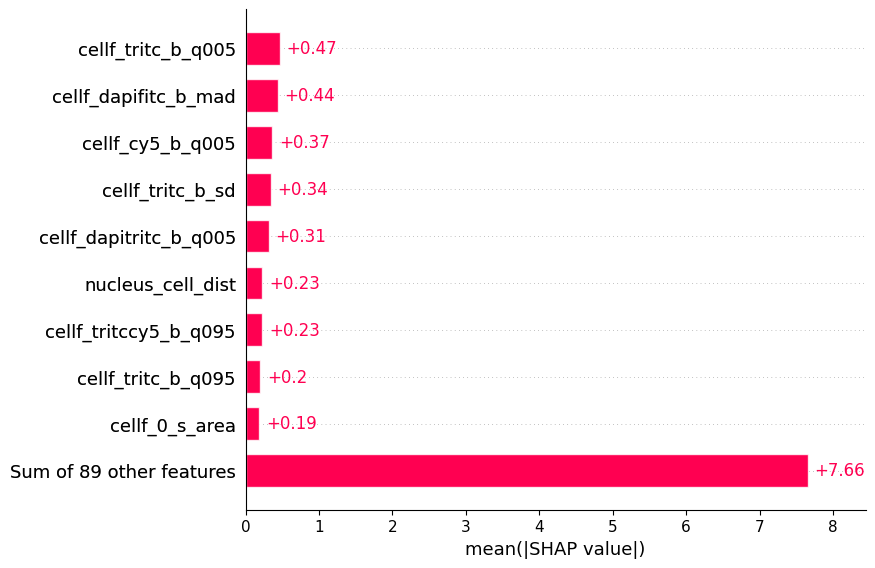

In [ ]:
shap.plots.bar(explanation)

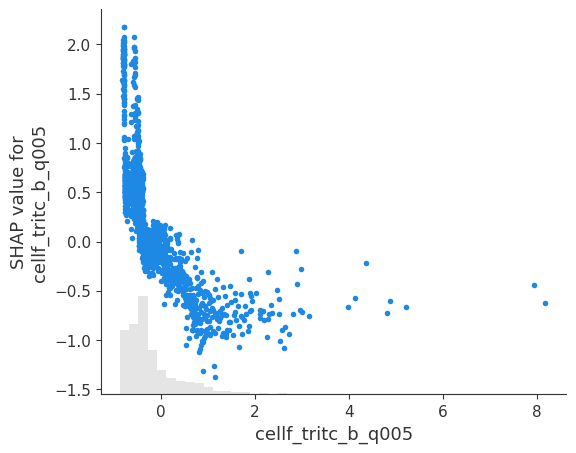

In [ ]:
shap.plots.scatter(explanation[:,"cellf_tritc_b_q005"])

In [ ]:
from explainerdashboard import ClassifierExplainer, ExplainerDashboard

underscored_X_val = X_val.copy()
underscored_X_val.columns = underscored_X_val.columns.str.replace('.', '_')
onehot_y_val = pd.get_dummies(y_val)['BC']

explainer = ClassifierExplainer(RF_george_under, underscored_X_val, onehot_y_val, labels=['Normal', 'BC'])

Detected RandomForestClassifier model: Changing class type to RandomForestClassifierExplainer...
Note: model_output=='probability', so assuming that raw shap output of RandomForestClassifier is in probability space...
Generating self.shap_explainer = shap.TreeExplainer(model)


In [ ]:
db = ExplainerDashboard(explainer, title="Screening Explainer for RFC George Under",
                        importances=True,
                        model_summary=False,
                        contributions=True,
                        whatif=True,
                        shap_dependence=True,
                        shap_interaction=False,
                        decision_trees=True,
                        labels=['Normal', 'BC'])

Building ExplainerDashboard..
Detected google colab environment, setting mode='external'
Generating layout...
Calculating shap values...


/usr/local/lib/python3.10/dist-packages/dash/dash.py:585: UserWarning:

JupyterDash is deprecated, use Dash instead.
See https://dash.plotly.com/dash-in-jupyter for more details.



Calculating dependencies...
Calculating permutation importances (if slow, try setting n_jobs parameter)...
Calculating prediction probabilities...
Calculating metrics...
Calculating ShadowDecTree for each individual decision tree...
Calculating predictions...
Reminder: you can store the explainer (including calculated dependencies) with explainer.dump('explainer.joblib') and reload with e.g. ClassifierExplainer.from_file('explainer.joblib')
Registering callbacks...


In [ ]:
db.to_yaml()

'dashboard:\n  explainerfile: explainer.joblib\n  params:\n    title: Screening Explainer for RFC George Under\n    name: null\n    description: "This dashboard shows the workings of a fitted\\n            machine\\\n      \\ learning model, and explains its predictions."\n    simple: false\n    hide_header: false\n    header_hide_title: false\n    header_hide_selector: false\n    header_hide_download: false\n    hide_poweredby: false\n    block_selector_callbacks: false\n    pos_label: null\n    fluid: true\n    mode: dash\n    width: 1000\n    height: 800\n    bootstrap: null\n    external_stylesheets: null\n    url_base_pathname: null\n    routes_pathname_prefix: null\n    requests_pathname_prefix: null\n    responsive: true\n    logins: null\n    port: 8050\n    importances: true\n    model_summary: false\n    contributions: true\n    whatif: true\n    shap_dependence: true\n    shap_interaction: false\n    decision_trees: true\n    kwargs:\n      labels:\n      - Normal\n      - B

In [ ]:
# Assuming db is the ExplainerDashboard object
import threading

# Create and start the dashboard in a separate thread
def run_dashboard():
    db.run(port=8051)

thread = threading.Thread(target=run_dashboard)
thread.start()

Starting ExplainerDashboard on http://172.28.0.12:8051
You can terminate the dashboard with ExplainerDashboard.terminate(8051)


Exception in thread Thread-17 (run_dashboard):
Traceback (most recent call last):
  File "/usr/lib/python3.10/threading.py", line 1016, in _bootstrap_inner
    self.run()
  File "/usr/lib/python3.10/threading.py", line 953, in run
    self._target(*self._args, **self._kwargs)
  File "<ipython-input-61-f8258e981fb8>", line 6, in run_dashboard
  File "/usr/local/lib/python3.10/dist-packages/explainerdashboard/dashboards.py", line 1299, in run
    app.run_server(port=port, mode=mode, **kwargs)
  File "/usr/local/lib/python3.10/dist-packages/jupyter_dash/jupyter_app.py", line 285, in run_server
    self._config_callback_exception_handling(
  File "/usr/local/lib/python3.10/dist-packages/jupyter_dash/jupyter_app.py", line 375, in _config_callback_exception_handling
    @self.server.errorhandler(Exception)
  File "/usr/local/lib/python3.10/dist-packages/flask/scaffold.py", line 49, in wrapper_func
    self._check_setup_finished(f_name)
  File "/usr/local/lib/python3.10/dist-packages/flask/ap